# --- DATA MODELING ---

# 0) Import Packages

In [1]:
import pandas as pd
pd.set_option("display.max_columns", None)
pd.set_option('display.max_rows', None)
import numpy as np
import pprint
import seaborn as sns
from datetime import datetime, timezone, timedelta
import time
import pytz
import re
import matplotlib.pyplot as plt
from random import randint
import pickle
import sklearn.model_selection as model
import sklearn.metrics as metrics
from sklearn.preprocessing import StandardScaler, MinMaxScaler
# classifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn import tree
import xgboost as xgb
# hyper-parameter tuning
from scipy.stats import randint as sp_randint
# neural network
import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization 
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import AUC

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
import sys
!{sys.executable} -m pip install imblearn
!{sys.executable} -m pip install shap
!{sys.executable} -m pip install lime
!{sys.executable} -m pip install eli5

from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import ClusterCentroids, RandomUnderSampler, NearMiss, TomekLinks
from imblearn.combine import SMOTETomek
import shap
from lime.lime_tabular import LimeTabularExplainer
import eli5
from eli5.sklearn import PermutationImportance

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 226.0/226.0 kB 29.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 298.0/298.0 kB 60.3 MB/s eta 0:00:00
  Attempting uninstall: joblib
    Found existing installation: joblib 1.1.0
    Uninstalling joblib-1.1.0:
      Successfully uninstalled joblib-1.1.0
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 572.4/572.4 kB 53.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.5/3.5 MB 78.3 MB/s eta 0:00:00:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.6/34.6 MB 38.5 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 32.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283838 sha256=ca0d6b9cba9600f3666d79033146acd47e6d000e2a5466cbaf284ac15592fdd9
  Stored in directory: /root/.cache/pip/wheels/ed/d7/c9/5a0130d06d6310bc6cbe55220e6e72dcb8c4eff9a478717066
Successfully built lime
     ━━━━━━━━━━━━━━━━━━━━━━

# 1) Data Loading & Splitting

In [45]:
# load data and split into train and test sets
def load_and_split_data(filepath, target, size=-1, year=-1):
    
    # load data
    df = pd.read_csv(filepath)
    
    # drop correlated features
    df.drop(['grade','pub_rec','total_acc','installment'], inplace=True, axis=1)
    
    # filter on selected year(s)
    if year:
        df = df[df['issue_d'].isin(year)]
    df.drop(['issue_d'], inplace=True, axis=1)
    
    # random sample (if selected)
    if size>0:
        df = df.sample(n=size, replace=False, random_state=42)
    
    # X and y splitting
    y = df[target]
    X = df.drop(target, axis=1)
    
    # train-test-valid splitting
    #X_train, X_rem, y_train, y_rem = train_test_split(X, y, train_size=0.75)
    #X_valid, X_test, y_valid, y_test = train_test_split(X_rem, y_rem, test_size=0.5)

    # train-test splitting
    X_train, X_test, y_train, y_test = model.train_test_split(X, y, train_size=0.75, random_state=42)
    
    return X_train, X_test, y_train, y_test

# 2) Data Preprocessing

## a) Class Balancing

In [46]:
# apply over/under-sampling methods for class balancing
def class_balancer(X, y, method, sampling_strategy=1, version=1, n_neighbors=3):
    
    ### OVER-SAMPLING ###
    # SMOTE
    if method=="SMOTE":    
        sampler = SMOTE(sampling_strategy=sampling_strategy, random_state=42)
    
    
    ### UNDER-SAMPLING ###
    # ClusterCentroid
    elif method=="ClusterCentroids":
        sampler = ClusterCentroids(sampling_strategy=sampling_strategy, random_state=42)
    
    # RandomUnderSampler
    elif method=="RandomUnder":
        sampler = RandomUnderSampler(sampling_strategy=sampling_strategy, random_state=42)
    
    # NearMiss
    elif method=="NearMiss":
        sampler = NearMiss(sampling_strategy=sampling_strategy, version=version, n_neighbors=n_neighbors)
        
    # TomekLinks
    elif method=="Tomek":
        sampler = TomekLinks(sampling_strategy=sampling_strategy)

        
    ### HYBRID ###
    # SMOTE-Tomek
    elif method=="SMOTETomek":
        sampler = SMOTETomek(sampling_strategy=sampling_strategy, random_state=42)
        

    # "invalid method" catch    
    else:
        print("Please select a valid method!")
        return
    
    
    # apply sampling method
    X, y = sampler.fit_resample(X, y)
    
    return X, y

## b) Feature Scaling (Standardization & Normalization)

In [48]:
cols_to_scale = ['loan_amnt', 'int_rate', 'sub_grade', 'emp_length', 'annual_inc', 'dti',
                 'open_acc', 'revol_bal', 'revol_util', 'pub_rec_bankruptcies', 'mort_acc',
                 'fico', 'yrs_cr_line']

# apply normalization or standardization scaling and return scaled data as well as scaler
def scaler_fit_transform(df, cols, scaler):
    
    out = df.copy()
    
    if scaler == 'norm':
        scaler = MinMaxScaler()
    elif scaler == 'stand':
        scaler = StandardScaler()
    
    for col in cols:
        # fit scaler and transform train
        temp = np.array(out[col]).reshape(-1,1)
        out[col] = scaler.fit_transform(temp)
        
    return out, scaler

# use already fitted scaler to e.g. scale test set or new observations
def scaler_transform(df, cols, scaler_fitted):
    
    out = df.copy()
    
    for col in cols:
        # fit scaler and transform train
        temp = np.array(out[col]).reshape(-1,1)
        out[col] = scaler_fitted.transform(temp)
        
    return out

## c) Train/Test-Data Selection

In [47]:
# select the respective datasets based on selected scaling and sampling method as well as sampling size 
def select_X_y(X_train, y_train, X_test, y_test, sampler=None, scaler=None, size=-1,
               sampling_strategy=1, version=0, n_neighbors=0):

    if sampler:
        X_train, y_train = class_balancer(X_train, y_train, sampler, sampling_strategy, version, n_neighbors)
            
    if scaler:
        X_train, scaler_fitted = scaler_fit_transform(X_train, cols_to_scale, scaler)
        X_test = scaler_transform(X_test, cols_to_scale, scaler_fitted)
            
    # random sample (if selected)
    if size>0:
        X_train = X_train.sample(n=size, replace=False, random_state=42)
        y_train = y_train[y_train.index]

    return X_train, y_train, X_test, y_test

# 3) Data Modeling

## a) Model Fitting

#### i) "White Box" Algorithms

In [8]:
# fit classifier
def fit_model(X, y, clf):
    
    # create copy of input classifier
    clf_temp = clf
    
    # fit the model
    clf_temp = clf_temp.fit(X, y)
    
    return clf_temp

#### ii) Neural Network ("Black Box")

In [9]:
# learning evolution plot
def plot_learning_evolution(clf):
    plt.figure(figsize=(12, 8))
    
    plt.subplot(2, 2, 1)
    plt.plot(clf.history['loss'], label='Loss')
    plt.plot(clf.history['val_loss'], label='val_Loss')
    plt.title('Loss evolution during trainig')
    plt.legend()

    plt.subplot(2, 2, 2)
    plt.plot(clf.history['AUC'], label='AUC')
    plt.plot(clf.history['val_AUC'], label='val_AUC')
    plt.title('AUC score evolution during trainig')
    plt.legend()

# fit neural network
def fit_nn(X_train, y_train, X_test, y_test, num_cols, num_labels, hidden_units, dropout_rates, 
           learn_rate, epochs=20, batch_size=32):
    
    inp = tf.keras.layers.Input(shape=(num_cols))
    x = BatchNormalization()(inp)
    x = Dropout(dropout_rates[0])(x)
    for i in range(len(hidden_units)):
        x = Dense(hidden_units[i], activation='relu')(x)
        x = BatchNormalization()(x)
        x = Dropout(dropout_rates[i + 1])(x)
    x = Dense(num_labels, activation='sigmoid')(x)
  
    clf = Model(inputs=inp, outputs=x)
    clf.compile(optimizer=Adam(learn_rate), loss='binary_crossentropy', metrics=[AUC(name='AUC')])
    
    clf = clf.fit(X_train, y_train,
                  validation_data=(X_test, y_test),
                  epochs=epochs,
                  batch_size=batch_size)
    
    #plot_learning_evolution(clf)
    
    return clf

## b) Model Deployment / Predicting

In [10]:
# make predictions using fitted classifier
def predict(X, clf, thres=0.5):
    
    # make predcitions
    y_prob = clf.predict_proba(X)[:,1]
    y_pred = [1 if x >= thres else 0 for x in y_prob]
    
    return y_pred, y_prob

## c) Parameter Optimization

### i) Optimal Classifier Threshold

In [49]:
# return summary table that shows performance metrics across different classifier threshold levels
def grid_search_thres(clf, X_test, y_test, step=0.01, show=False):
    
    # initialize output table
    thres_grid = pd.DataFrame(index=['Accuracy', 'Balanced Acc', 'Precision', 'Recall', 'F1','AUC'])

    # stepwise loop through threshold levels
    for i in np.arange(0, 1.0, step):
        # assign target labels based on current threshold
        y_pred, y_prob = predict(X_test, clf, thres=i)
        
        # add metrics to output table
        thres_grid[i] = [round(metrics.accuracy_score(y_test, y_pred),4),
                         round(metrics.balanced_accuracy_score(y_test, y_pred),4),
                         round(metrics.precision_score(y_test, y_pred),4),
                         round(metrics.recall_score(y_test, y_pred),4),
                         round(metrics.f1_score(y_test, y_pred, average='weighted'),4),
                         round(metrics.roc_auc_score(y_test, y_prob),4)]
        
    if show: display(thres_grid)
            
    return thres_grid

In [50]:
# compute the optimal threshold level using Youden's J statistic or Precision-Recall Curve approach
def get_opt_thres(clf, X_test, y_test):
    
    y_prob = clf.predict_proba(X_test)[:,1]
    
    # Youden’s J statistic
    fpr, tpr, thresholds = metrics.roc_curve(y_test, y_prob)
    score = tpr - fpr
    
    # Precision-Recall Curve
    """
    precision, recall, thresholds = metrics.precision_recall_curve(y_test, y_prob)
    score = (2 * precision * recall) / (precision + recall)
    """
    
    i = np.argmax(score)
    opt_thres = thresholds[i]
    print('Optimal Threshold: %.4f' % (opt_thres))
    
    return opt_thres

In [51]:
# plot all evaluation metrics with moving threshold level
def plot_thres(clf, X_test, y_test, step=0.01, metric=None):
            
    # threshold grid search table
    thres_grid = grid_search_thres(clf, X_test, y_test, step)

    # get optimal threshold
    opt_thres = get_opt_thres(clf, X_test, y_test)
    
    # plot curve for selected metric
    if metric != None:
        temp = pd.DataFrame(thres_grid.loc[metric]).reset_index()
        temp.rename(columns = {'index':'Threshold'}, inplace = True)
        plt.ylim(0, 1)
        sns.lineplot(data=temp, x='Threshold', y=metric).set(title='Threshold Tuning Curve for '+metric)
        plt.axvline(opt_thres, color='r')
        plt.text(opt_thres+0.03, 0.9,'t=%.2f' % opt_thres, color='r')
        
    # plot curves for all metrics
    else:
        i = 1
        m_list = list(thres_grid.index.values)
        del m_list[-1]
        for m in m_list:
            temp = pd.DataFrame(thres_grid.loc[m]).reset_index()
            temp.rename(columns = {'index':'Threshold'}, inplace = True)
            plt.figure(figsize=(15, 5))
            plt.subplot(3, 2, i)
            plt.ylim(0, 1)
            sns.lineplot(data=temp, x='Threshold', y=m).set(title='Threshold Tuning Curve for '+m)
            plt.axvline(opt_thres, color='r')
            plt.text(opt_thres+0.03, 0.9,'t=%.2f' % opt_thres, color='r')
            i += 1

### ii) Hyper-Parameters: Random Search

In [14]:
# hyper-parameter tuning using random search
def random_search(X, y, clf, params, n_iter=5, cv=3, k_fold=3, scoring='balanced_accuracy'):
    
    # shuffle splitting
    cv = model.ShuffleSplit(n_splits=k_fold, test_size=0.3, random_state=42)
    
    # define random search parameters
    randomCV = model.RandomizedSearchCV(clf, param_distributions=params, n_iter=n_iter, cv=cv, scoring=scoring, random_state=42)
    
    # fit models
    randomCV.fit(X, y)
    
    return randomCV.best_estimator_, randomCV.best_params_, randomCV.cv_results_

### iii) Hyper-Parameters: Bayesian Optimization

In [15]:
#hyper-parameter tuning using bayesian optimization
def bayesian_opt():
    
    return 1

### iv) Optimal Dataset Parameters

In [16]:
# find optimal sampling and scaling method for specific classifier and year 
def get_optimal_data(df, clf, year=2018, metric='AUC'):
    
    # find index for optimal score for selected clf and year 
    idx = df.loc[(df['Year']==year) & (df['Clf']==clf)][[metric]].idxmax()
    
    # extract optimal parameters
    scaler = str(df.loc[idx, 'Scaling'][0])
    sampler = str(df.loc[idx, 'Sampling'][0])
    
    if scaler=='non':
        scaler = None
    if sampler=='non':
        sampler = None
    
    return scaler, sampler 

## d) Cross-Validation

In [17]:
# cross-validate model
def cv_model(X, y, clf, clf_name, k_fold=3):
    
    # shuffle split
    cv = model.ShuffleSplit(n_splits=k_fold, test_size=0.3, random_state=42)

    # initialize scoring metrics and summary tables
    scoring = ['accuracy','balanced_accuracy','precision','recall','f1','roc_auc']
    model_eval = pd.DataFrame(index=['Accuracy', 'Bal_Acc', 'Precision', 'Recall', 'F1', 'AUC'])
    model_eval_detail = pd.DataFrame(index=['Fold', 'Fit_Time', 'Score_Time', 'Accuracy', 'Bal_Acc', 'Precision', 'Recall', 'F1', 'AUC'])

    cv_scores = model.cross_validate(clf, X, y, cv=cv, scoring=scoring, return_estimator=True)

    # CV aggegrated scores
    model_eval[clf_name] = [round(cv_scores['test_accuracy'].mean(),4),
                            round(cv_scores['test_balanced_accuracy'].mean(),4),
                            round(cv_scores['test_precision'].mean(),4),
                            round(cv_scores['test_recall'].mean(),4),
                            round(cv_scores['test_f1'].mean(),4),
                            round(cv_scores['test_roc_auc'].mean(),4)]
    
    # CV scores for each fold
    model_eval_detail[clf_name] = [list(range(1,len(cv_scores['test_accuracy'])+1)),
                                   np.round(cv_scores['fit_time'],2),
                                   np.round(cv_scores['score_time'],2),
                                   np.round(cv_scores['test_accuracy'],4),
                                   np.round(cv_scores['test_balanced_accuracy'],4),
                                   np.round(cv_scores['test_precision'],4),
                                   np.round(cv_scores['test_recall'],4),
                                   np.round(cv_scores['test_f1'],4),
                                   np.round(cv_scores['test_roc_auc'],4)]
    
    #display(model_eval)
    #display(model_eval_detail)

    return model_eval, model_eval_detail

## e) Model Evaluation

In [52]:
# evaluate (final) model
def eval_model(X_test, y_test, X_train, y_train, clf_fitted, clf_name, thres=0.5, show=True):
    
    # initialize scoring metrics and summary table
    scoring = ['accuracy','balanced_accuracy','precision','recall','f1','roc_auc']
    model_eval = pd.DataFrame(index=['RunTime', 'Accuracy', 'Bal_Acc', 'Precision', 'Recall', 'F1', 'AUC'])
    
    # get preds and probs
    start_time = time.time()
    y_pred_train, y_prob_train = predict(X_train, clf_fitted, thres)
    train_time = time.time()
    y_pred_test, y_prob_test = predict(X_test, clf_fitted, thres)
    test_time = time.time()
    
    # model scores
    model_eval[clf_name+'_train'] = [str(timedelta(seconds=train_time-start_time)),
                                     round(metrics.accuracy_score(y_train, y_pred_train),4),
                                     round(metrics.balanced_accuracy_score(y_train, y_pred_train),4),
                                     round(metrics.precision_score(y_train, y_pred_train),4),
                                     round(metrics.recall_score(y_train, y_pred_train),4),
                                     round(metrics.f1_score(y_train, y_pred_train, average='weighted'),4),
                                     round(metrics.roc_auc_score(y_train, y_prob_train),4)]
    
    model_eval[clf_name+'_test'] = [str(timedelta(seconds=test_time-train_time)),
                                    round(metrics.accuracy_score(y_test, y_pred_test),4),
                                    round(metrics.balanced_accuracy_score(y_test, y_pred_test),4),
                                    round(metrics.precision_score(y_test, y_pred_test),4),
                                    round(metrics.recall_score(y_test, y_pred_test),4),
                                    round(metrics.f1_score(y_test, y_pred_test, average='weighted'),4),
                                    round(metrics.roc_auc_score(y_test, y_prob_test),4)]
    
    
    display(model_eval.transpose())
    
    # confusion matrix and ROC curve
    cm = metrics.ConfusionMatrixDisplay.from_estimator(clf_fitted, X_test, y_test, cmap='cividis', display_labels=['Fully-Paid','Default'])
    roc = metrics.RocCurveDisplay.from_estimator(clf_fitted, X_test, y_test)
    
    return model_eval.transpose(), cm, roc

## f) Model Saving

In [53]:
# save fitted classifier
def pickle_model(clf, clf_name):
    # save the model to disk
    filename = 'Models/'+clf_name+'.sav'
    pickle.dump(clf, open(filename, 'wb'))
    
    return "Model saved as: "+clf_name

# 4) XAI - Model Explainability

## a) SHAP

In [54]:
# output various SHAP plots
def run_shap(clf, X, i=0):
    
    #shap.initjs()
    
    explainer = shap.Explainer(clf, X)
    shap_values = explainer(X)
    
    # force plot
    #shap.force_plot(explainer.expected_value, shap_values[i], X[i], feature_names = features)
    
    # waterfall plot
    plt.figure(figsize=(50, 20))
    shap.plots.waterfall(shap_values[i], max_display=25, show=False)
    plt.show()      
    
    # summary plot
    plt.figure(figsize=(50, 20))
    shap.summary_plot(shap_values, X, max_display=25, show=False)
    plt.show()
    
    
    # mean SHAP
    plt.figure(figsize=(50, 20))
    shap.plots.bar(shap_values, max_display=25, show=False)
    plt.show()
    
    # dependence plot
    #shap.dependence_plot(5, shap_values, X, feature_names=['annual_inc','fico'])
    #shap.dependence_plot('annual_inc', shap_values[1], X, interaction_index="annual_inc")
    
    return shap_values

## b) LIME

In [55]:
# output LIME plot
def run_lime(X_train, X_test, clf, i=0):
        
    # get the class names
    class_names = ['No default', 'Default']

    # get the (categorical) feature names
    feature_names = list(X_train.columns)
    
    categorical_names = [col for col in X_train 
                if np.isin(X_train[col].dropna().unique(), [0, 1]).all()]
    categorical_features = [X_train.columns.get_loc(c) for c in categorical_names 
                            if c in X_train]

    # fit the Explainer on the train data
    explainer = LimeTabularExplainer(X_train.values, 
                                     feature_names=feature_names, 
                                     class_names=class_names,
                                     categorical_features=categorical_features, 
                                     categorical_names=categorical_names,
                                     mode='classification')
    
    # local explanation on the i-th instance in test data
    explaination = explainer.explain_instance(X_test.iloc[i], clf.predict_proba)
    explaination.show_in_notebook(show_table = True, show_all = False)

## c) PFI - Permutation Feature Importance

In [56]:
# output PFI plot
def run_pfi(X, y, clf):
    
    perm = PermutationImportance(clf, random_state=42).fit(X, y)
    return eli5.show_weights(perm, feature_names=X.columns.tolist())

# 5) Master-Function (Full Pipeline)

## a) Fit-Predict-Evaluate (single model)

In [23]:
# fit classifier, get preds and probs, evaluate model
def fit_pred_eval(X_test, y_test, X_train, y_train, clf, clf_name, thres=0.5, show=True):
    
    #start_time = time.time()
    
    # fit classifier
    clf_fit = fit_model(X_train, y_train, clf)
    
    # evaluate classifier
    model_eval, cm, roc = eval_model(X_test, y_test, X_train, y_train, clf_fit, clf_name, thres=thres, show=False)
    
    # save model
    pickle_model(clf_fit, clf_name+'_'+datetime.now(pytz.timezone('US/Pacific')).strftime("%d-%m-%Y_%H-%M"))
    
    
    return model_eval.transpose()

## b) End-to-End Pipeline (single/multiple models)

In [57]:
# fun full ML pipeline on all combinations of selected algorithm types, years, sampling and scaling methods, output evaluation summary table
def master_func_eval(clf_list, clf_name_list, sampling_methods, scaling_methods, 
                     target='default', year=[2015], thres=0.5, size=-1, show=False):
    
    # initialize summary tables for model evaluation
    model_eval = pd.DataFrame(index=['RunTime', 'Accuracy', 'Bal_Acc', 'Precision', 'Recall', 'F1', 'AUC'])
    
    # loop through years
    for yr in year:
        
        start_time = time.time()
        
        # data loading and splitting
        X_train_main, X_test_main, y_train_main, y_test_main = load_and_split_data('Data/data_clean_full.csv', target, size=size, year=[yr])

        load_time = time.time() - start_time
        
        # set classifier index
        i = 0

        # loop through all committed classifiers, sampling and scaling methods
        for clf in clf_list:   
            for sampler in sampling_methods:   
                for scaler in scaling_methods:

                    start_time = time.time()
                    
                    # select datasets
                    X_train, y_train, X_test, y_test = select_X_y(X_train_main, y_train_main, X_test_main, y_test_main,
                                                                  sampler=sampler, scaler=scaler, size=size,
                                                                  sampling_strategy=1, version=0, n_neighbors=0)

                    # generate classifier name
                    clf_name = str(yr) + '_' + clf_name_list[i]
                    if sampler:
                        clf_name += '_' + sampler

                    if scaler:
                        clf_name += '_' + scaler

                    # fit, predict and evaluate model
                    model_eval[clf_name] = fit_pred_eval(X_train, y_train, X_test, y_test, clf, clf_name, thres=thres, show=show).iloc[:,1]

                    # store run time
                    model_eval.loc['RunTime', clf_name] = str(timedelta(seconds=time.time()-start_time+load_time))

            # increase classifier index
            i += 1
    
    # transpose output table
    model_eval = model_eval.transpose()
    
    # split clf_name
    s = model_eval.index.str.split('_')
    
    # initialize new columns
    model_eval[['Year', 'Clf', 'Scaling', 'Sampling']] = ''
    
    # extract year, classifier, samping and scaling method
    for i in range(model_eval.shape[0]):
        model_eval['Year'][i] = s[i][0]
        model_eval['Clf'][i] = s[i][1]
        if len(s[i])==4:
            model_eval['Sampling'][i] = s[i][2]
            model_eval['Scaling'][i] = s[i][3] 
        elif len(s[i])==3:
            if s[i][2] in sampling_methods:
                model_eval['Sampling'][i] = s[i][2]
                model_eval['Scaling'][i] = 'non'
            elif s[i][2] in scaling_methods:
                model_eval['Scaling'][i] = s[i][2]
                model_eval['Sampling'][i] = 'non'  
        else:
            model_eval['Sampling'][i] = 'non'
            model_eval['Scaling'][i] = 'non'
            
    # save output table as csv
    model_eval.to_csv('Master_output/master_output_'+datetime.now(pytz.timezone('US/Pacific')).strftime("%d-%m-%Y_%H-%M")+'.csv')
        
    return model_eval

## c) Output Plots

In [59]:
# plot model performance for all years and classifiers 
def plot_all_yrs(data):
    
    # drop RunTime column
    df = data.drop(['RunTime'], inplace=False, axis=1)
    
    yrs = df['Year'].unique()
    
    df = pd.melt(df, id_vars =['Year','Clf','Sampling','Scaling'],
                 value_vars =['Accuracy','Bal_Acc','Precision','Recall','F1','AUC'],
                 var_name ='Metric', value_name ='Score')
    
    df_grouped = pd.DataFrame(df.groupby(['Year','Metric'])['Score'].mean())
    df_grouped.reset_index(inplace=True)
    
    # plot mean scores by year
    plt.figure(figsize=(20, 5))
    plt.subplot(1, 2, 1)
    sns.lineplot(x = 'Year', y = 'Score', hue='Metric', data=df_grouped)
    plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
    plt.subplot(1, 2, 2)
    sns.barplot(x = 'Metric', y = 'Score', hue='Year', data=df_grouped)
    plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
    plt.suptitle('Mean Scores by Year')
    plt.show()
    
    df_grouped = pd.DataFrame(df.groupby(['Year','Clf','Metric'])['Score'].mean())
    df_grouped.reset_index(inplace=True)

    for yr in yrs:
        plt.figure(figsize=(20, 15))
        sns.catplot(x='Clf', y='Score',
                    col='Metric', kind='bar', col_wrap=6,
                    palette='deep', data=df_grouped[df_grouped['Year']==yr])
        plt.suptitle('Year - %s' % (yr), y=1.05, size=24)
        plt.show()

In [60]:
# plot model performance for all classifiers for selected year, while adding sampling and scaling dimension
def plot_one_yr(data, yr):
    
    # drop RunTime column and filter on selected year
    df = data.drop(['RunTime'], inplace=False, axis=1)
    df = df[df['Year']==yr]
    
    df = pd.melt(df, id_vars =['Clf','Sampling','Scaling'],
                 value_vars =['Accuracy','Bal_Acc','Precision','Recall','F1','AUC'],
                 var_name ='Metric', value_name ='Score')
        
    for clf in df['Clf'].unique():

        df_grouped = df[df['Clf']==clf]
        df_grouped = pd.DataFrame(df_grouped.groupby(['Clf','Metric', 'Sampling', 'Scaling'])['Score'].mean())
        df_grouped.reset_index(inplace=True)

        plt.figure(figsize=(20, 20))
        sns.catplot(x='Sampling', y='Score', hue='Scaling',
                    col='Metric', kind='bar', col_wrap=6,
                    palette='deep', data=df_grouped)
        plt.suptitle('%s (%i)' % (clf, yr), y=1.05, size=24)
        plt.show()

## -- OUTPUT -- All Classifiers: with/without class balancing and scaling

In [27]:
# initialize all classifiers
clf_lr = LogisticRegression(solver='lbfgs', class_weight='balanced', max_iter=800, random_state=42)
clf_dt = tree.DecisionTreeClassifier(criterion='gini', splitter='best', max_depth=3, 
                                     class_weight='balanced', random_state=42)
clf_nb = GaussianNB()
clf_rf = RandomForestClassifier(n_estimators=100, class_weight='balanced', random_state=42)
clf_xgb = XGBClassifier(objective='binary:logistic', use_label_encoder=False, random_state=42)

In [28]:
# select classifiers to commit to master function
clf_list = [clf_lr, clf_nb, clf_dt, clf_rf, clf_xgb]
clf_name_list = ['LR', 'NB', 'DT', 'RF', 'XGB']

# define dataset parameters
sampling_methods = [None, 'SMOTE', 'RandomUnder']
scaling_methods = [None, 'norm', 'stand']
year_list = [2013, 2014, 2015, 2016, 2017, 2018, 2019]

#### ~ FULL OUTPUT ~ (DO NOT RERUN)

,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_LR_train,0:00:00.017038,0.6418,0.6344,0.2462,0.6237,0.6898,0.6857
2013_LR_test,0:00:00.086222,0.6415,0.634,0.2408,0.6231,0.6908,0.684


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_LR_norm_train,0:00:00.022849,0.6491,0.6403,0.2516,0.6276,0.6958,0.6949
2013_LR_norm_test,0:00:00.083501,0.1537,0.5003,0.1532,0.9999,0.0419,0.6847


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_LR_stand_train,0:00:00.017607,0.6443,0.636,0.2479,0.6241,0.6918,0.6887
2013_LR_stand_test,0:00:00.078459,0.5749,0.6322,0.2229,0.7147,0.6335,0.6804


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_LR_SMOTE_train,0:00:00.018908,0.6418,0.6344,0.2462,0.6237,0.6898,0.6857
2013_LR_SMOTE_test,0:00:00.170905,0.6348,0.6348,0.6375,0.6247,0.6347,0.6863


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_LR_SMOTE_norm_train,0:00:00.042870,0.6491,0.6403,0.2516,0.6276,0.6958,0.6949
2013_LR_SMOTE_norm_test,0:00:00.115772,0.5003,0.5003,0.5002,1.0,0.3341,0.6479


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_LR_SMOTE_stand_train,0:00:00.017913,0.644,0.6357,0.2476,0.6237,0.6916,0.6885
2013_LR_SMOTE_stand_test,0:00:00.113211,0.6309,0.6309,0.6279,0.6429,0.6309,0.6799


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_LR_RandomUnder_train,0:00:00.016422,0.6418,0.6344,0.2462,0.6237,0.6898,0.6857
2013_LR_RandomUnder_test,0:00:00.032994,0.6326,0.6326,0.6352,0.6231,0.6326,0.6821


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_LR_RandomUnder_norm_train,0:00:00.041867,0.6491,0.6403,0.2516,0.6276,0.6958,0.6949
2013_LR_RandomUnder_norm_test,0:00:00.018260,0.5003,0.5003,0.5001,0.9999,0.3341,0.6835


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_LR_RandomUnder_stand_train,0:00:00.017420,0.6441,0.6358,0.2477,0.6237,0.6917,0.6887
2013_LR_RandomUnder_stand_test,0:00:00.042166,0.6322,0.6322,0.6299,0.6414,0.6322,0.6791


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_NB_train,0:00:00.055847,0.7973,0.5753,0.3159,0.2519,0.7877,0.6718
2013_NB_test,0:00:00.177156,0.799,0.574,0.3075,0.2497,0.7903,0.6729


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_NB_norm_train,0:00:00.058248,0.709,0.5878,0.2449,0.4112,0.7361,0.6354
2013_NB_norm_test,0:00:00.187991,0.8469,0.5,0.0,0.0,0.7767,0.5751


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_NB_stand_train,0:00:00.056140,0.786,0.5935,0.3157,0.3131,0.7856,0.682
2013_NB_stand_test,0:00:00.187348,0.8469,0.5,0.0,0.0,0.7767,0.5659


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_NB_SMOTE_train,0:00:00.060050,0.7973,0.5753,0.3159,0.2519,0.7877,0.6718
2013_NB_SMOTE_test,0:00:00.442086,0.5591,0.5591,0.6838,0.2199,0.5018,0.6832


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_NB_SMOTE_norm_train,0:00:00.060638,0.709,0.5878,0.2449,0.4112,0.7361,0.6354
2013_NB_SMOTE_norm_test,0:00:00.301229,0.5,0.5,0.0,0.0,0.3333,0.563


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_NB_SMOTE_stand_train,0:00:00.051982,0.7872,0.5927,0.3169,0.3094,0.7862,0.6819
2013_NB_SMOTE_stand_test,0:00:00.356300,0.5,0.5,0.0,0.0,0.3333,0.5527


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_NB_RandomUnder_train,0:00:00.060812,0.7973,0.5753,0.3159,0.2519,0.7877,0.6718
2013_NB_RandomUnder_test,0:00:00.073527,0.5726,0.5726,0.7048,0.2497,0.5228,0.6707


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_NB_RandomUnder_norm_train,0:00:00.052142,0.709,0.5878,0.2449,0.4112,0.7361,0.6354
2013_NB_RandomUnder_norm_test,0:00:00.052290,0.5,0.5,0.0,0.0,0.3333,0.5722


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_NB_RandomUnder_stand_train,0:00:00.061774,0.7864,0.5938,0.3166,0.3133,0.7859,0.682
2013_NB_RandomUnder_stand_test,0:00:00.057790,0.5,0.5,0.0,0.0,0.3333,0.5558


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_DT_train,0:00:00.021753,0.5767,0.6301,0.2271,0.7079,0.6337,0.6747
2013_DT_test,0:00:00.063650,0.5773,0.6274,0.2214,0.6995,0.6358,0.6687


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_DT_norm_train,0:00:00.022614,0.5767,0.6301,0.2271,0.7079,0.6337,0.6747
2013_DT_norm_test,0:00:00.067725,0.5038,0.6176,0.2055,0.7817,0.5644,0.6473


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_DT_stand_train,0:00:00.021238,0.5767,0.6301,0.2271,0.7079,0.6337,0.6747
2013_DT_stand_test,0:00:00.071540,0.4446,0.608,0.1955,0.8436,0.499,0.6515


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_DT_SMOTE_train,0:00:00.021615,0.5767,0.6301,0.2271,0.7079,0.6337,0.6747
2013_DT_SMOTE_test,0:00:00.164134,0.6315,0.6315,0.6141,0.7077,0.6293,0.6556


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_DT_SMOTE_norm_train,0:00:00.021688,0.5767,0.6301,0.2271,0.7079,0.6337,0.6747
2013_DT_SMOTE_norm_test,0:00:00.113103,0.6354,0.6354,0.5993,0.8172,0.6229,0.6527


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_DT_SMOTE_stand_train,0:00:00.021069,0.5767,0.6301,0.2271,0.7079,0.6337,0.6747
2013_DT_SMOTE_stand_test,0:00:00.114792,0.6354,0.6354,0.5993,0.8172,0.6229,0.6445


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_DT_RandomUnder_train,0:00:00.021127,0.5767,0.6301,0.2271,0.7079,0.6337,0.6747
2013_DT_RandomUnder_test,0:00:00.036640,0.6265,0.6265,0.6104,0.6995,0.6245,0.6661


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_DT_RandomUnder_norm_train,0:00:00.023258,0.5767,0.6301,0.2271,0.7079,0.6337,0.6747
2013_DT_RandomUnder_norm_test,0:00:00.022424,0.6168,0.6168,0.5878,0.7817,0.6061,0.6454


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_DT_RandomUnder_stand_train,0:00:00.022911,0.5767,0.6301,0.2271,0.7079,0.6337,0.6747
2013_DT_RandomUnder_stand_test,0:00:00.021811,0.6168,0.6168,0.5878,0.7817,0.6061,0.6518


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_RF_train,0:00:01.042551,1.0,0.9999,1.0,0.9998,1.0,1.0
2013_RF_test,0:00:03.039167,0.8464,0.5036,0.4312,0.0093,0.7791,0.6739


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_RF_norm_train,0:00:01.131121,1.0,0.9999,1.0,0.9998,1.0,1.0
2013_RF_norm_test,0:00:01.610757,0.8469,0.5,0.0,0.0,0.7767,0.6052


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_RF_stand_train,0:00:01.057132,1.0,0.9999,1.0,0.9998,1.0,1.0
2013_RF_stand_test,0:00:01.834679,0.8469,0.5,0.0,0.0,0.7767,0.6039


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_RF_SMOTE_train,0:00:01.022914,1.0,0.9999,1.0,0.9998,1.0,1.0
2013_RF_SMOTE_test,0:00:04.560601,0.5036,0.5036,0.8078,0.0094,0.3431,0.673


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_RF_SMOTE_norm_train,0:00:01.041890,1.0,0.9999,1.0,0.9998,1.0,1.0
2013_RF_SMOTE_norm_test,0:00:03.110996,0.5,0.5,0.0,0.0,0.3333,0.5806


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_RF_SMOTE_stand_train,0:00:01.060365,1.0,0.9999,1.0,0.9998,1.0,1.0
2013_RF_SMOTE_stand_test,0:00:02.992672,0.5,0.5,0.0,0.0,0.3333,0.5854


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_RF_RandomUnder_train,0:00:01.111804,1.0,0.9999,1.0,0.9998,1.0,1.0
2013_RF_RandomUnder_test,0:00:00.953091,0.5036,0.5036,0.807,0.0093,0.3431,0.6707


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_RF_RandomUnder_norm_train,0:00:00.934566,1.0,0.9999,1.0,0.9998,1.0,1.0
2013_RF_RandomUnder_norm_test,0:00:00.471687,0.5,0.5,0.0,0.0,0.3333,0.6067


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_RF_RandomUnder_stand_train,0:00:00.940391,1.0,0.9999,1.0,0.9998,1.0,1.0
2013_RF_RandomUnder_stand_test,0:00:00.458780,0.5,0.5,0.0,0.0,0.3333,0.6027


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_XGB_train,0:00:00.094110,0.8797,0.6193,0.9688,0.24,0.8473,0.9145
2013_XGB_test,0:00:00.249037,0.8398,0.5131,0.3231,0.0422,0.7841,0.6661


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_XGB_norm_train,0:00:00.097591,0.8797,0.6193,0.9688,0.24,0.8473,0.9145
2013_XGB_norm_test,0:00:00.276068,0.8371,0.5056,0.232,0.0277,0.779,0.582


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_XGB_stand_train,0:00:00.099173,0.8797,0.6193,0.9688,0.24,0.8473,0.9145
2013_XGB_stand_test,0:00:00.281839,0.8423,0.5022,0.2207,0.012,0.7777,0.5746


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_XGB_SMOTE_train,0:00:00.091861,0.8797,0.6193,0.9688,0.24,0.8473,0.9145
2013_XGB_SMOTE_test,0:00:00.502075,0.5026,0.5026,0.5695,0.0211,0.3525,0.6764


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_XGB_SMOTE_norm_train,0:00:00.115669,0.8797,0.6193,0.9688,0.24,0.8473,0.9145
2013_XGB_SMOTE_norm_test,0:00:00.515801,0.5008,0.5008,0.523,0.0182,0.3492,0.5853


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_XGB_SMOTE_stand_train,0:00:00.102435,0.8797,0.6193,0.9688,0.24,0.8473,0.9145
2013_XGB_SMOTE_stand_test,0:00:00.434474,0.5002,0.5002,0.526,0.0049,0.3378,0.5785


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_XGB_RandomUnder_train,0:00:00.101624,0.8797,0.6193,0.9688,0.24,0.8473,0.9145
2013_XGB_RandomUnder_test,0:00:00.110433,0.5124,0.5124,0.7075,0.0422,0.374,0.6624


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_XGB_RandomUnder_norm_train,0:00:00.101827,0.8797,0.6193,0.9688,0.24,0.8473,0.9145
2013_XGB_RandomUnder_norm_test,0:00:00.082950,0.5052,0.5052,0.6156,0.0277,0.3591,0.5831


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2013_XGB_RandomUnder_stand_train,0:00:00.084861,0.8797,0.6193,0.9688,0.24,0.8473,0.9145
2013_XGB_RandomUnder_stand_test,0:00:00.079332,0.5018,0.5018,0.6436,0.0082,0.3413,0.5802


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_LR_train,0:00:00.051835,0.6397,0.6343,0.2718,0.6259,0.6818,0.6868
2014_LR_test,0:00:00.100179,0.6428,0.6378,0.2723,0.6301,0.6849,0.6912


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_LR_norm_train,0:00:00.044935,0.6482,0.645,0.2803,0.6402,0.6891,0.6991
2014_LR_norm_test,0:00:00.109683,0.1747,0.5004,0.174,0.9999,0.0532,0.6955


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_LR_stand_train,0:00:00.056769,0.6446,0.6392,0.276,0.6309,0.6859,0.691
2014_LR_stand_test,0:00:00.135411,0.5725,0.6374,0.2513,0.7369,0.6229,0.6922


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_LR_SMOTE_train,0:00:00.030275,0.6397,0.6343,0.2718,0.6259,0.6818,0.6868
2014_LR_SMOTE_test,0:00:00.405041,0.6403,0.6403,0.6418,0.6353,0.6403,0.6927


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_LR_SMOTE_norm_train,0:00:00.035351,0.6482,0.645,0.2803,0.6402,0.6891,0.6991
2014_LR_SMOTE_norm_test,0:00:00.214782,0.5005,0.5005,0.5002,1.0,0.3345,0.6536


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_LR_SMOTE_stand_train,0:00:00.034700,0.6441,0.6381,0.2753,0.6288,0.6855,0.6906
2014_LR_SMOTE_stand_test,0:00:00.244072,0.6392,0.6392,0.6324,0.6649,0.639,0.6889


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_LR_RandomUnder_train,0:00:00.030050,0.6397,0.6343,0.2718,0.6259,0.6818,0.6868
2014_LR_RandomUnder_test,0:00:00.089068,0.6359,0.6359,0.6375,0.6301,0.6359,0.6896


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_LR_RandomUnder_norm_train,0:00:00.053732,0.6482,0.645,0.2803,0.6402,0.6891,0.6991
2014_LR_RandomUnder_norm_test,0:00:00.036054,0.5005,0.5005,0.5003,0.9999,0.3346,0.6935


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_LR_RandomUnder_stand_train,0:00:00.037063,0.6444,0.6389,0.2758,0.6303,0.6858,0.691
2014_LR_RandomUnder_stand_test,0:00:00.055379,0.6376,0.6376,0.6311,0.6622,0.6374,0.6904


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_NB_train,0:00:00.087947,0.7764,0.5844,0.3393,0.2885,0.7691,0.6775
2014_NB_test,0:00:00.363498,0.781,0.5874,0.3457,0.2904,0.7733,0.6818


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_NB_norm_train,0:00:00.084275,0.6936,0.5873,0.2661,0.4234,0.7183,0.6323
2014_NB_norm_test,0:00:00.454071,0.8261,0.5,0.0,0.0,0.7474,0.5874


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_NB_stand_train,0:00:00.083896,0.7671,0.6012,0.3397,0.3456,0.7679,0.6892
2014_NB_stand_test,0:00:00.383033,0.8261,0.5,0.0,0.0,0.7474,0.5849


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_NB_SMOTE_train,0:00:00.110136,0.7764,0.5844,0.3393,0.2885,0.7691,0.6775
2014_NB_SMOTE_test,0:00:00.935122,0.5721,0.5721,0.692,0.2599,0.5259,0.6893


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_NB_SMOTE_norm_train,0:00:00.096553,0.6936,0.5873,0.2661,0.4234,0.7183,0.6323
2014_NB_SMOTE_norm_test,0:00:00.818934,0.5,0.5,0.0,0.0,0.3333,0.5782


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_NB_SMOTE_stand_train,0:00:00.089864,0.7677,0.6003,0.3398,0.3422,0.768,0.689
2014_NB_SMOTE_stand_test,0:00:00.819627,0.5,0.5,0.0,0.0,0.3333,0.5711


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_NB_RandomUnder_train,0:00:00.085737,0.7764,0.5844,0.3393,0.2885,0.7691,0.6775
2014_NB_RandomUnder_test,0:00:00.114500,0.5865,0.5865,0.7119,0.2904,0.5467,0.6804


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_NB_RandomUnder_norm_train,0:00:00.087147,0.6936,0.5873,0.2661,0.4234,0.7183,0.6323
2014_NB_RandomUnder_norm_test,0:00:00.118022,0.5,0.5,0.0,0.0,0.3333,0.5848


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_NB_RandomUnder_stand_train,0:00:00.087173,0.7671,0.6011,0.3397,0.3452,0.7679,0.6892
2014_NB_RandomUnder_stand_test,0:00:00.091126,0.5,0.5,0.0,0.0,0.3333,0.5763


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_DT_train,0:00:00.033249,0.5586,0.6291,0.2469,0.7379,0.6093,0.6751
2014_DT_test,0:00:00.098899,0.5597,0.6318,0.2461,0.7423,0.6109,0.6771


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_DT_norm_train,0:00:00.038064,0.5586,0.6291,0.2469,0.7379,0.6093,0.6751
2014_DT_norm_test,0:00:00.143249,0.4789,0.6195,0.2278,0.8352,0.5261,0.6339


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_DT_stand_train,0:00:00.040494,0.5586,0.6291,0.2469,0.7379,0.6093,0.6751
2014_DT_stand_test,0:00:00.111314,0.3915,0.5951,0.2103,0.9074,0.4182,0.609


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_DT_SMOTE_train,0:00:00.032613,0.5586,0.6291,0.2469,0.7379,0.6093,0.6751
2014_DT_SMOTE_test,0:00:00.433075,0.6369,0.6369,0.6112,0.7526,0.632,0.6951


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_DT_SMOTE_norm_train,0:00:00.033044,0.5586,0.6291,0.2469,0.7379,0.6093,0.6751
2014_DT_SMOTE_norm_test,0:00:00.238118,0.6302,0.6302,0.5896,0.8566,0.6102,0.6787


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_DT_SMOTE_stand_train,0:00:00.034515,0.5586,0.6291,0.2469,0.7379,0.6093,0.6751
2014_DT_SMOTE_stand_test,0:00:00.228232,0.6302,0.6302,0.5896,0.8566,0.6102,0.6784


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_DT_RandomUnder_train,0:00:00.031898,0.5586,0.6291,0.2469,0.7379,0.6093,0.6751
2014_DT_RandomUnder_test,0:00:00.057864,0.6313,0.6313,0.6074,0.7423,0.6267,0.6745


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_DT_RandomUnder_norm_train,0:00:00.039276,0.5586,0.6291,0.2469,0.7379,0.6093,0.6751
2014_DT_RandomUnder_norm_test,0:00:00.044185,0.6176,0.6176,0.582,0.8352,0.5986,0.6307


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_DT_RandomUnder_stand_train,0:00:00.033608,0.5586,0.6291,0.2469,0.7379,0.6093,0.6751
2014_DT_RandomUnder_stand_test,0:00:00.037324,0.6176,0.6176,0.582,0.8352,0.5986,0.6312


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_RF_train,0:00:01.910962,1.0,1.0,1.0,1.0,1.0,1.0
2014_RF_test,0:00:06.287969,0.8257,0.5067,0.4709,0.0175,0.7528,0.6849


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_RF_norm_train,0:00:01.808745,1.0,1.0,1.0,1.0,1.0,1.0
2014_RF_norm_test,0:00:02.794613,0.8261,0.5,0.0,0.0,0.7474,0.5802


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_RF_stand_train,0:00:02.319000,1.0,1.0,1.0,1.0,1.0,1.0
2014_RF_stand_test,0:00:03.101667,0.8261,0.5,0.0,0.0,0.7474,0.5612


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_RF_SMOTE_train,0:00:02.384481,1.0,1.0,1.0,1.0,1.0,1.0
2014_RF_SMOTE_test,0:00:11.399429,0.5071,0.5071,0.8161,0.0183,0.3524,0.683


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_RF_SMOTE_norm_train,0:00:01.977856,1.0,1.0,1.0,1.0,1.0,1.0
2014_RF_SMOTE_norm_test,0:00:06.039655,0.5,0.5,0.0,0.0,0.3333,0.5607


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_RF_SMOTE_stand_train,0:00:02.110567,1.0,1.0,1.0,1.0,1.0,1.0
2014_RF_SMOTE_stand_test,0:00:05.666807,0.5,0.5,0.0,0.0,0.3333,0.5479


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_RF_RandomUnder_train,0:00:02.128037,1.0,1.0,1.0,1.0,1.0,1.0
2014_RF_RandomUnder_test,0:00:02.067438,0.5069,0.5069,0.829,0.0175,0.3516,0.6845


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_RF_RandomUnder_norm_train,0:00:02.288554,1.0,1.0,1.0,1.0,1.0,1.0
2014_RF_RandomUnder_norm_test,0:00:01.278641,0.5,0.5,0.0,0.0,0.3333,0.5792


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_RF_RandomUnder_stand_train,0:00:02.138678,1.0,1.0,1.0,1.0,1.0,1.0
2014_RF_RandomUnder_stand_test,0:00:01.241351,0.5,0.5,0.0,0.0,0.3333,0.5677


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_XGB_train,0:00:00.166738,0.8524,0.5852,0.9255,0.1733,0.8077,0.8662
2014_XGB_test,0:00:00.463127,0.8215,0.5171,0.3957,0.0504,0.7599,0.6809


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_XGB_norm_train,0:00:00.162721,0.8524,0.5852,0.9255,0.1733,0.8077,0.8662
2014_XGB_norm_test,0:00:00.505136,0.6876,0.5303,0.2103,0.2891,0.7058,0.5576


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_XGB_stand_train,0:00:00.163399,0.8524,0.5852,0.9255,0.1733,0.8077,0.8662
2014_XGB_stand_test,0:00:00.563973,0.7112,0.526,0.2115,0.2421,0.7187,0.5539


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_XGB_SMOTE_train,0:00:00.194783,0.8524,0.5852,0.9255,0.1733,0.8077,0.8662
2014_XGB_SMOTE_test,0:00:01.063807,0.5032,0.5032,0.5817,0.0225,0.3539,0.6789


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_XGB_SMOTE_norm_train,0:00:00.163483,0.8524,0.5852,0.9255,0.1733,0.8077,0.8662
2014_XGB_SMOTE_norm_test,0:00:00.817851,0.4782,0.4782,0.4474,0.185,0.4292,0.487


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_XGB_SMOTE_stand_train,0:00:00.166139,0.8524,0.5852,0.9255,0.1733,0.8077,0.8662
2014_XGB_SMOTE_stand_test,0:00:00.831531,0.4868,0.4868,0.4609,0.156,0.4237,0.4927


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_XGB_RandomUnder_train,0:00:00.171265,0.8524,0.5852,0.9255,0.1733,0.8077,0.8662
2014_XGB_RandomUnder_test,0:00:00.248002,0.5171,0.5171,0.7562,0.0504,0.3826,0.679


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_XGB_RandomUnder_norm_train,0:00:00.166052,0.8524,0.5852,0.9255,0.1733,0.8077,0.8662
2014_XGB_RandomUnder_norm_test,0:00:00.174375,0.5304,0.5304,0.5587,0.2891,0.5014,0.5585


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2014_XGB_RandomUnder_stand_train,0:00:00.175030,0.8524,0.5852,0.9255,0.1733,0.8077,0.8662
2014_XGB_RandomUnder_stand_test,0:00:00.161286,0.5172,0.5172,0.5441,0.2127,0.4679,0.5394


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_LR_train,0:00:00.074306,0.6608,0.6502,0.3146,0.6328,0.6942,0.7093
2015_LR_test,0:00:00.229002,0.6603,0.649,0.3145,0.6305,0.6936,0.7077


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_LR_norm_train,0:00:00.078092,0.6736,0.6629,0.3275,0.6454,0.7053,0.7229
2015_LR_norm_test,0:00:00.271231,0.1949,0.5,0.1949,1.0,0.0636,0.718


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_LR_stand_train,0:00:00.051140,0.6663,0.6525,0.3185,0.6298,0.6988,0.7123
2015_LR_stand_test,0:00:00.258127,0.5975,0.6515,0.2907,0.7401,0.6389,0.7109


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_LR_SMOTE_train,0:00:00.070363,0.6608,0.6502,0.3146,0.6328,0.6942,0.7093
2015_LR_SMOTE_test,0:00:00.729374,0.6518,0.6518,0.6567,0.6361,0.6517,0.711


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_LR_SMOTE_norm_train,0:00:00.047481,0.6736,0.6629,0.3275,0.6454,0.7053,0.7229
2015_LR_SMOTE_norm_test,0:00:00.422412,0.5,0.5,0.5,1.0,0.3334,0.6663


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_LR_SMOTE_stand_train,0:00:00.078380,0.666,0.6523,0.3183,0.63,0.6985,0.7119
2015_LR_SMOTE_stand_test,0:00:00.374029,0.6523,0.6523,0.649,0.6634,0.6523,0.7085


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_LR_RandomUnder_train,0:00:00.075890,0.6608,0.6502,0.3146,0.6328,0.6942,0.7093
2015_LR_RandomUnder_test,0:00:00.137796,0.6493,0.6493,0.6552,0.6305,0.6492,0.7077


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_LR_RandomUnder_norm_train,0:00:00.072158,0.6736,0.6629,0.3275,0.6454,0.7053,0.7229
2015_LR_RandomUnder_norm_test,0:00:00.116875,0.5,0.5,0.5,1.0,0.3334,0.7178


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_LR_RandomUnder_stand_train,0:00:00.054472,0.6662,0.6524,0.3184,0.6297,0.6987,0.7123
2015_LR_RandomUnder_stand_test,0:00:00.113128,0.6527,0.6527,0.6501,0.6615,0.6527,0.711


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_NB_train,0:00:00.197223,0.7632,0.6164,0.3873,0.3764,0.7619,0.7027
2015_NB_test,0:00:00.841677,0.762,0.6154,0.3861,0.375,0.7607,0.7006


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_NB_norm_train,0:00:00.175276,0.6893,0.6147,0.3109,0.4927,0.7126,0.6562
2015_NB_norm_test,0:00:00.841709,0.8051,0.5,0.0,0.0,0.7182,0.6077


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_NB_stand_train,0:00:00.230631,0.7554,0.6299,0.3832,0.4248,0.7601,0.7119
2015_NB_stand_test,0:00:00.849790,0.8051,0.5,0.0,0.0,0.7182,0.6044


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_NB_SMOTE_train,0:00:00.286513,0.7632,0.6164,0.3873,0.3764,0.7619,0.7027
2015_NB_SMOTE_test,0:00:01.683417,0.6049,0.6049,0.7104,0.3541,0.5784,0.7084


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_NB_SMOTE_norm_train,0:00:00.172556,0.6893,0.6147,0.3109,0.4927,0.7126,0.6562
2015_NB_SMOTE_norm_test,0:00:01.378907,0.5,0.5,0.0,0.0,0.3333,0.6023


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_NB_SMOTE_stand_train,0:00:00.168422,0.7564,0.63,0.3847,0.4233,0.7607,0.7117
2015_NB_SMOTE_stand_test,0:00:01.378002,0.5,0.5,0.0,0.0,0.3333,0.5852


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_NB_RandomUnder_train,0:00:00.221478,0.7632,0.6164,0.3873,0.3764,0.7619,0.7027
2015_NB_RandomUnder_test,0:00:00.375866,0.6154,0.6154,0.7222,0.375,0.5918,0.7006


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_NB_RandomUnder_norm_train,0:00:00.228330,0.6893,0.6147,0.3109,0.4927,0.7126,0.6562
2015_NB_RandomUnder_norm_test,0:00:00.270460,0.5,0.5,0.0,0.0,0.3333,0.6073


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_NB_RandomUnder_stand_train,0:00:00.263759,0.7555,0.63,0.3834,0.4246,0.7602,0.7119
2015_NB_RandomUnder_stand_test,0:00:00.320259,0.5,0.5,0.0,0.0,0.3333,0.5928


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_DT_train,0:00:00.058854,0.7017,0.6474,0.338,0.5587,0.7256,0.7036
2015_DT_test,0:00:00.243742,0.6995,0.6434,0.3352,0.5515,0.7234,0.7003


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_DT_norm_train,0:00:00.066293,0.7017,0.6474,0.338,0.5587,0.7256,0.7036
2015_DT_norm_test,0:00:00.261704,0.6328,0.6501,0.3027,0.6785,0.6707,0.6959


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_DT_stand_train,0:00:00.063727,0.7017,0.6474,0.338,0.5587,0.7256,0.7036
2015_DT_stand_test,0:00:00.294258,0.5794,0.647,0.2834,0.7577,0.6218,0.6911


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_DT_SMOTE_train,0:00:00.080802,0.7017,0.6474,0.338,0.5587,0.7256,0.7036
2015_DT_SMOTE_test,0:00:00.777092,0.6059,0.6059,0.6429,0.4766,0.5992,0.6864


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_DT_SMOTE_norm_train,0:00:00.063406,0.7017,0.6474,0.338,0.5587,0.7256,0.7036
2015_DT_SMOTE_norm_test,0:00:00.463826,0.6441,0.6441,0.6379,0.6665,0.6439,0.6889


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_DT_SMOTE_stand_train,0:00:00.057004,0.7017,0.6474,0.338,0.5587,0.7256,0.7036
2015_DT_SMOTE_stand_test,0:00:00.467499,0.643,0.643,0.6397,0.6551,0.643,0.6896


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_DT_RandomUnder_train,0:00:00.059742,0.7017,0.6474,0.338,0.5587,0.7256,0.7036
2015_DT_RandomUnder_test,0:00:00.127094,0.6433,0.6433,0.6755,0.5515,0.6402,0.6997


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_DT_RandomUnder_norm_train,0:00:00.063308,0.7017,0.6474,0.338,0.5587,0.7256,0.7036
2015_DT_RandomUnder_norm_test,0:00:00.085386,0.6501,0.6501,0.642,0.6785,0.6498,0.6955


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_DT_RandomUnder_stand_train,0:00:00.065467,0.7017,0.6474,0.338,0.5587,0.7256,0.7036
2015_DT_RandomUnder_stand_test,0:00:00.075423,0.6492,0.6492,0.6438,0.6679,0.649,0.6954


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_RF_train,0:00:03.971392,1.0,1.0,1.0,1.0,1.0,1.0
2015_RF_test,0:00:11.365871,0.8058,0.5253,0.5124,0.0656,0.74,0.7099


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_RF_norm_train,0:00:03.955567,1.0,1.0,1.0,1.0,1.0,1.0
2015_RF_norm_test,0:00:06.738942,0.8051,0.5,0.0,0.0,0.7182,0.6681


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_RF_stand_train,0:00:03.775400,1.0,1.0,1.0,1.0,1.0,1.0
2015_RF_stand_test,0:00:06.829056,0.8051,0.5,0.0,0.0,0.7182,0.6594


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_RF_SMOTE_train,0:00:04.151965,1.0,1.0,1.0,1.0,1.0,1.0
2015_RF_SMOTE_test,0:00:19.150742,0.5281,0.5281,0.8253,0.0714,0.4037,0.7046


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_RF_SMOTE_norm_train,0:00:04.037823,1.0,1.0,1.0,1.0,1.0,1.0
2015_RF_SMOTE_norm_test,0:00:10.654532,0.5,0.5,0.0,0.0,0.3333,0.6291


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_RF_SMOTE_stand_train,0:00:03.880570,1.0,1.0,1.0,1.0,1.0,1.0
2015_RF_SMOTE_stand_test,0:00:10.402874,0.5,0.5,0.0,0.0,0.3333,0.6076


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_RF_RandomUnder_train,0:00:03.984259,1.0,1.0,1.0,1.0,1.0,1.0
2015_RF_RandomUnder_test,0:00:04.748935,0.5255,0.5255,0.8173,0.0656,0.3982,0.7101


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_RF_RandomUnder_norm_train,0:00:03.803122,1.0,1.0,1.0,1.0,1.0,1.0
2015_RF_RandomUnder_norm_test,0:00:02.672789,0.5,0.5,0.0,0.0,0.3333,0.6672


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_RF_RandomUnder_stand_train,0:00:04.006620,1.0,1.0,1.0,1.0,1.0,1.0
2015_RF_RandomUnder_stand_test,0:00:02.457393,0.5,0.5,0.0,0.0,0.3333,0.6553


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_XGB_train,0:00:00.305061,0.8316,0.5885,0.7685,0.1908,0.7879,0.826
2015_XGB_test,0:00:00.941277,0.8048,0.5407,0.4954,0.1081,0.7505,0.7136


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_XGB_norm_train,0:00:00.273948,0.8316,0.5885,0.7685,0.1908,0.7879,0.826
2015_XGB_norm_test,0:00:00.904818,0.804,0.5058,0.4272,0.0173,0.7238,0.6429


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_XGB_stand_train,0:00:00.277644,0.8316,0.5885,0.7685,0.1908,0.7879,0.826
2015_XGB_stand_test,0:00:00.957652,0.8043,0.5031,0.4058,0.0095,0.7213,0.636


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_XGB_SMOTE_train,0:00:00.293851,0.8316,0.5885,0.7685,0.1908,0.7879,0.826
2015_XGB_SMOTE_test,0:00:01.936039,0.5181,0.5181,0.702,0.0628,0.3921,0.7071


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_XGB_SMOTE_norm_train,0:00:00.293694,0.8316,0.5885,0.7685,0.1908,0.7879,0.826
2015_XGB_SMOTE_norm_test,0:00:01.388536,0.5003,0.5003,0.5282,0.0063,0.339,0.5949


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_XGB_SMOTE_stand_train,0:00:00.273332,0.8316,0.5885,0.7685,0.1908,0.7879,0.826
2015_XGB_SMOTE_stand_test,0:00:01.551035,0.4999,0.4999,0.4899,0.0028,0.3357,0.5763


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_XGB_RandomUnder_train,0:00:00.286949,0.8316,0.5885,0.7685,0.1908,0.7879,0.826
2015_XGB_RandomUnder_test,0:00:00.386385,0.5407,0.5407,0.8013,0.1081,0.435,0.7141


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_XGB_RandomUnder_norm_train,0:00:00.278763,0.8316,0.5885,0.7685,0.1908,0.7879,0.826
2015_XGB_RandomUnder_norm_test,0:00:00.370898,0.5056,0.5056,0.7407,0.0173,0.3508,0.6431


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2015_XGB_RandomUnder_stand_train,0:00:00.301846,0.8316,0.5885,0.7685,0.1908,0.7879,0.826
2015_XGB_RandomUnder_stand_test,0:00:00.353761,0.5026,0.5026,0.7254,0.0082,0.3417,0.636


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_LR_train,0:00:00.030465,0.6679,0.6476,0.3126,0.6148,0.7006,0.7078
2016_LR_test,0:00:00.117535,0.6692,0.6547,0.3203,0.6311,0.7014,0.7141


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_LR_norm_train,0:00:00.026000,0.6818,0.6624,0.3276,0.631,0.7126,0.7257
2016_LR_norm_test,0:00:00.141604,0.1938,0.5001,0.1937,1.0,0.0631,0.7251


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_LR_stand_train,0:00:00.027288,0.6731,0.6513,0.3172,0.616,0.7049,0.7114
2016_LR_stand_test,0:00:00.134611,0.6145,0.6558,0.2968,0.7231,0.6549,0.7157


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_LR_SMOTE_train,0:00:00.057612,0.6679,0.6476,0.3126,0.6148,0.7006,0.7078
2016_LR_SMOTE_test,0:00:00.387978,0.6598,0.6598,0.6659,0.6412,0.6596,0.7207


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_LR_SMOTE_norm_train,0:00:00.056604,0.6818,0.6624,0.3276,0.631,0.7126,0.7257
2016_LR_SMOTE_norm_test,0:00:00.206647,0.5001,0.5001,0.5,1.0,0.3335,0.6633


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_LR_SMOTE_stand_train,0:00:00.031541,0.6787,0.6575,0.3234,0.6233,0.7098,0.7177
2016_LR_SMOTE_stand_test,0:00:00.202749,0.6578,0.6578,0.657,0.6607,0.6578,0.717


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_LR_RandomUnder_train,0:00:00.030895,0.6679,0.6476,0.3126,0.6148,0.7006,0.7078
2016_LR_RandomUnder_test,0:00:00.088242,0.655,0.655,0.6628,0.6311,0.6548,0.7146


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_LR_RandomUnder_norm_train,0:00:00.050803,0.6818,0.6624,0.3276,0.631,0.7126,0.7257
2016_LR_RandomUnder_norm_test,0:00:00.035114,0.5001,0.5001,0.5,1.0,0.3334,0.7255


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_LR_RandomUnder_stand_train,0:00:00.049446,0.6731,0.6512,0.3172,0.6157,0.7049,0.7113
2016_LR_RandomUnder_stand_test,0:00:00.033149,0.6557,0.6557,0.6615,0.6377,0.6556,0.7156


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_NB_train,0:00:00.088505,0.7727,0.6068,0.3909,0.3381,0.7663,0.7012
2016_NB_test,0:00:00.431449,0.7737,0.6145,0.404,0.3546,0.7679,0.7066


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_NB_norm_train,0:00:00.099476,0.6471,0.6324,0.2951,0.6087,0.683,0.6643
2016_NB_norm_test,0:00:00.431589,0.8063,0.5,0.0,0.0,0.7199,0.6212


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_NB_stand_train,0:00:00.093222,0.7607,0.6291,0.384,0.4161,0.7643,0.7133
2016_NB_stand_test,0:00:00.435292,0.8063,0.5,0.0,0.0,0.7199,0.6284


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_NB_SMOTE_train,0:00:00.132601,0.7727,0.6068,0.3909,0.3381,0.7663,0.7012
2016_NB_SMOTE_test,0:00:00.899832,0.6061,0.6061,0.7289,0.3378,0.5755,0.717


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_NB_SMOTE_norm_train,0:00:00.095781,0.6471,0.6324,0.2951,0.6087,0.683,0.6643
2016_NB_SMOTE_norm_test,0:00:00.702358,0.5,0.5,0.0,0.0,0.3333,0.6243


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_NB_SMOTE_stand_train,0:00:00.094722,0.7619,0.6274,0.3848,0.4096,0.7647,0.7129
2016_NB_SMOTE_stand_test,0:00:00.706748,0.5,0.5,0.0,0.0,0.3333,0.6013


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_NB_RandomUnder_train,0:00:00.098234,0.7727,0.6068,0.3909,0.3381,0.7663,0.7012
2016_NB_RandomUnder_test,0:00:00.142675,0.6153,0.6153,0.741,0.3546,0.5873,0.707


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_NB_RandomUnder_norm_train,0:00:00.103327,0.6471,0.6324,0.2951,0.6087,0.683,0.6643
2016_NB_RandomUnder_norm_test,0:00:00.115922,0.5,0.5,0.0,0.0,0.3333,0.6217


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_NB_RandomUnder_stand_train,0:00:00.119157,0.7609,0.6291,0.3843,0.4155,0.7645,0.7132
2016_NB_RandomUnder_stand_test,0:00:00.141501,0.5,0.5,0.0,0.0,0.3333,0.6138


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_DT_train,0:00:00.034676,0.5736,0.6496,0.2784,0.7725,0.6173,0.7046
2016_DT_test,0:00:00.092492,0.5735,0.6504,0.2817,0.7758,0.6162,0.7067


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_DT_norm_train,0:00:00.032642,0.5736,0.6496,0.2784,0.7725,0.6173,0.7046
2016_DT_norm_test,0:00:00.136703,0.4974,0.6345,0.2592,0.8584,0.5355,0.707


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_DT_stand_train,0:00:00.031981,0.5736,0.6496,0.2784,0.7725,0.6173,0.7046
2016_DT_stand_test,0:00:00.137335,0.4087,0.6032,0.2364,0.9206,0.426,0.699


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_DT_SMOTE_train,0:00:00.044490,0.5736,0.6496,0.2784,0.7725,0.6173,0.7046
2016_DT_SMOTE_test,0:00:00.367400,0.6655,0.6655,0.6292,0.806,0.6587,0.7034


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_DT_SMOTE_norm_train,0:00:00.033348,0.5736,0.6496,0.2784,0.7725,0.6173,0.7046
2016_DT_SMOTE_norm_test,0:00:00.251520,0.643,0.643,0.5976,0.8753,0.6226,0.6963


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_DT_SMOTE_stand_train,0:00:00.034343,0.5736,0.6496,0.2784,0.7725,0.6173,0.7046
2016_DT_SMOTE_stand_test,0:00:00.219018,0.6499,0.6499,0.6007,0.8942,0.6277,0.7006


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_DT_RandomUnder_train,0:00:00.030146,0.5736,0.6496,0.2784,0.7725,0.6173,0.7046
2016_DT_RandomUnder_test,0:00:00.062643,0.6509,0.6509,0.6208,0.7758,0.6454,0.7068


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_DT_RandomUnder_norm_train,0:00:00.035754,0.5736,0.6496,0.2784,0.7725,0.6173,0.7046
2016_DT_RandomUnder_norm_test,0:00:00.045256,0.6357,0.6357,0.5939,0.8584,0.6166,0.7073


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_DT_RandomUnder_stand_train,0:00:00.035009,0.5736,0.6496,0.2784,0.7725,0.6173,0.7046
2016_DT_RandomUnder_stand_test,0:00:00.046448,0.6345,0.6345,0.5926,0.8609,0.6148,0.7061


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_RF_train,0:00:01.819865,1.0,1.0,1.0,1.0,1.0,1.0
2016_RF_test,0:00:05.502402,0.8088,0.5335,0.5414,0.0841,0.7477,0.7173


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_RF_norm_train,0:00:01.995422,1.0,1.0,1.0,1.0,1.0,1.0
2016_RF_norm_test,0:00:03.003097,0.8063,0.5,0.0,0.0,0.7199,0.656


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_RF_stand_train,0:00:01.839085,1.0,1.0,1.0,1.0,1.0,1.0
2016_RF_stand_test,0:00:03.081748,0.8063,0.5,0.0,0.0,0.7199,0.6547


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_RF_SMOTE_train,0:00:01.878577,1.0,1.0,1.0,1.0,1.0,1.0
2016_RF_SMOTE_test,0:00:09.064323,0.5332,0.5332,0.8298,0.0835,0.4148,0.7147


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_RF_SMOTE_norm_train,0:00:01.925246,1.0,1.0,1.0,1.0,1.0,1.0
2016_RF_SMOTE_norm_test,0:00:05.049876,0.5,0.5,0.0,0.0,0.3333,0.6144


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_RF_SMOTE_stand_train,0:00:01.706543,1.0,1.0,1.0,1.0,1.0,1.0
2016_RF_SMOTE_stand_test,0:00:05.093048,0.5,0.5,0.0,0.0,0.3333,0.5932


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_RF_RandomUnder_train,0:00:01.712337,1.0,1.0,1.0,1.0,1.0,1.0
2016_RF_RandomUnder_test,0:00:02.258692,0.5338,0.5338,0.835,0.0841,0.4156,0.7186


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_RF_RandomUnder_norm_train,0:00:01.703953,1.0,1.0,1.0,1.0,1.0,1.0
2016_RF_RandomUnder_norm_test,0:00:01.334185,0.5,0.5,0.0,0.0,0.3333,0.656


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_RF_RandomUnder_stand_train,0:00:01.873156,1.0,1.0,1.0,1.0,1.0,1.0
2016_RF_RandomUnder_stand_test,0:00:01.164082,0.5,0.5,0.0,0.0,0.3333,0.6504


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_XGB_train,0:00:00.144209,0.8524,0.6315,0.8564,0.2738,0.8198,0.8752
2016_XGB_test,0:00:00.438676,0.8058,0.5509,0.4949,0.1348,0.7581,0.7119


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_XGB_norm_train,0:00:00.142125,0.8524,0.6315,0.8564,0.2738,0.8198,0.8752
2016_XGB_norm_test,0:00:00.519840,0.6226,0.5673,0.2507,0.477,0.6583,0.597


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_XGB_stand_train,0:00:00.142334,0.8524,0.6315,0.8564,0.2738,0.8198,0.8752
2016_XGB_stand_test,0:00:00.443244,0.6615,0.5911,0.2801,0.4763,0.6898,0.6314


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_XGB_SMOTE_train,0:00:00.146752,0.8524,0.6315,0.8564,0.2738,0.8198,0.8752
2016_XGB_SMOTE_test,0:00:00.875596,0.5263,0.5263,0.7213,0.0856,0.4121,0.7118


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_XGB_SMOTE_norm_train,0:00:00.168871,0.8524,0.6315,0.8564,0.2738,0.8198,0.8752
2016_XGB_SMOTE_norm_test,0:00:00.713457,0.5041,0.5041,0.506,0.3507,0.4922,0.5238


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_XGB_SMOTE_stand_train,0:00:00.176922,0.8524,0.6315,0.8564,0.2738,0.8198,0.8752
2016_XGB_SMOTE_stand_test,0:00:00.790632,0.5181,0.5181,0.5286,0.3341,0.5012,0.5515


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_XGB_RandomUnder_train,0:00:00.158330,0.8524,0.6315,0.8564,0.2738,0.8198,0.8752
2016_XGB_RandomUnder_test,0:00:00.214589,0.5512,0.5512,0.8058,0.1348,0.4571,0.7137


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_XGB_RandomUnder_norm_train,0:00:00.145277,0.8524,0.6315,0.8564,0.2738,0.8198,0.8752
2016_XGB_RandomUnder_norm_test,0:00:00.186681,0.5676,0.5676,0.5824,0.4776,0.5641,0.5964


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2016_XGB_RandomUnder_stand_train,0:00:00.165431,0.8524,0.6315,0.8564,0.2738,0.8198,0.8752
2016_XGB_RandomUnder_stand_test,0:00:00.168399,0.5785,0.5785,0.6041,0.4557,0.5721,0.6143


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_LR_train,0:00:00.039278,0.6531,0.6414,0.3425,0.6205,0.6806,0.6961
2017_LR_test,0:00:00.073543,0.6544,0.6415,0.3514,0.6179,0.6803,0.6984


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_LR_norm_train,0:00:00.025131,0.6592,0.642,0.3462,0.6112,0.6856,0.6977
2017_LR_norm_test,0:00:00.076965,0.3711,0.5734,0.258,0.9438,0.3493,0.6922


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_LR_stand_train,0:00:00.021204,0.6593,0.6465,0.3485,0.6236,0.686,0.7
2017_LR_stand_test,0:00:00.074260,0.6145,0.6421,0.3324,0.6928,0.6457,0.6957


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_LR_SMOTE_train,0:00:00.039972,0.6531,0.6414,0.3425,0.6205,0.6806,0.6961
2017_LR_SMOTE_test,0:00:00.179782,0.6436,0.6436,0.6501,0.6221,0.6434,0.7026


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_LR_SMOTE_norm_train,0:00:00.041748,0.6592,0.642,0.3462,0.6112,0.6856,0.6977
2017_LR_SMOTE_norm_test,0:00:00.141212,0.5851,0.5851,0.5482,0.9673,0.5142,0.6586


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_LR_SMOTE_stand_train,0:00:00.016066,0.6591,0.6461,0.3482,0.6227,0.6859,0.6996
2017_LR_SMOTE_stand_test,0:00:00.102556,0.6413,0.6413,0.6455,0.627,0.6413,0.6988


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_LR_RandomUnder_train,0:00:00.021383,0.6531,0.6414,0.3425,0.6205,0.6806,0.6961
2017_LR_RandomUnder_test,0:00:00.074322,0.6412,0.6412,0.6482,0.6179,0.6411,0.6984


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_LR_RandomUnder_norm_train,0:00:00.037802,0.6592,0.642,0.3462,0.6112,0.6856,0.6977
2017_LR_RandomUnder_norm_test,0:00:00.024566,0.5737,0.5737,0.5424,0.9438,0.5061,0.6926


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_LR_RandomUnder_stand_train,0:00:00.048697,0.6593,0.6465,0.3485,0.6236,0.686,0.7
2017_LR_RandomUnder_stand_test,0:00:00.031262,0.6421,0.6421,0.6481,0.6217,0.6419,0.6965


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_NB_train,0:00:00.053838,0.7469,0.5919,0.4058,0.3142,0.7347,0.6847
2017_NB_test,0:00:00.249607,0.7445,0.5928,0.4169,0.3148,0.7311,0.6893


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_NB_norm_train,0:00:00.057256,0.6458,0.617,0.326,0.5655,0.6728,0.6499
2017_NB_norm_test,0:00:00.269192,0.773,0.5,0.0,0.0,0.6741,0.6099


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_NB_stand_train,0:00:00.066463,0.742,0.6161,0.4116,0.3906,0.7396,0.703
2017_NB_stand_test,0:00:00.251026,0.773,0.5,0.0,0.0,0.6741,0.6145


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_NB_SMOTE_train,0:00:00.065801,0.7469,0.5919,0.4058,0.3142,0.7347,0.6847
2017_NB_SMOTE_test,0:00:00.474170,0.5824,0.5824,0.6947,0.2941,0.5446,0.6975


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_NB_SMOTE_norm_train,0:00:00.050910,0.6458,0.617,0.326,0.5655,0.6728,0.6499
2017_NB_SMOTE_norm_test,0:00:00.425387,0.5,0.5,0.0,0.0,0.3333,0.6025


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_NB_SMOTE_stand_train,0:00:00.051335,0.7422,0.6141,0.4108,0.3847,0.7391,0.7024
2017_NB_SMOTE_stand_test,0:00:00.403682,0.5,0.5,0.0,0.0,0.3333,0.5877


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_NB_RandomUnder_train,0:00:00.065928,0.7469,0.5919,0.4058,0.3142,0.7347,0.6847
2017_NB_RandomUnder_test,0:00:00.104368,0.5917,0.5917,0.7056,0.3148,0.5578,0.6891


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_NB_RandomUnder_norm_train,0:00:00.057182,0.6458,0.617,0.326,0.5655,0.6728,0.6499
2017_NB_RandomUnder_norm_test,0:00:00.077977,0.5,0.5,0.0,0.0,0.3333,0.6109


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_NB_RandomUnder_stand_train,0:00:00.057252,0.7419,0.6159,0.4113,0.3902,0.7394,0.703
2017_NB_RandomUnder_stand_test,0:00:00.080153,0.5,0.5,0.0,0.0,0.3333,0.6071


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_DT_train,0:00:00.020148,0.6662,0.6388,0.3488,0.5897,0.6909,0.6849
2017_DT_test,0:00:00.058398,0.6625,0.6346,0.3528,0.5833,0.6862,0.683


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_DT_norm_train,0:00:00.021324,0.6662,0.6388,0.3488,0.5897,0.6909,0.6849
2017_DT_norm_test,0:00:00.085147,0.5511,0.6318,0.3073,0.7795,0.5832,0.6424


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_DT_stand_train,0:00:00.021260,0.6662,0.6388,0.3488,0.5897,0.6909,0.6849
2017_DT_stand_test,0:00:00.064670,0.5511,0.6318,0.3073,0.7795,0.5832,0.6424


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_DT_SMOTE_train,0:00:00.021209,0.6662,0.6388,0.3488,0.5897,0.6909,0.6849
2017_DT_SMOTE_test,0:00:00.192426,0.648,0.648,0.6601,0.6102,0.6475,0.6998


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_DT_SMOTE_norm_train,0:00:00.020646,0.6662,0.6388,0.3488,0.5897,0.6909,0.6849
2017_DT_SMOTE_norm_test,0:00:00.129379,0.652,0.652,0.6138,0.82,0.6419,0.6631


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_DT_SMOTE_stand_train,0:00:00.021809,0.6662,0.6388,0.3488,0.5897,0.6909,0.6849
2017_DT_SMOTE_stand_test,0:00:00.104273,0.6459,0.6459,0.6226,0.7408,0.6427,0.6631


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_DT_RandomUnder_train,0:00:00.020717,0.6662,0.6388,0.3488,0.5897,0.6909,0.6849
2017_DT_RandomUnder_test,0:00:00.046922,0.6362,0.6362,0.6524,0.5833,0.6352,0.6837


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_DT_RandomUnder_norm_train,0:00:00.018778,0.6662,0.6388,0.3488,0.5897,0.6909,0.6849
2017_DT_RandomUnder_norm_test,0:00:00.027240,0.6316,0.6316,0.6016,0.7795,0.6234,0.6421


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_DT_RandomUnder_stand_train,0:00:00.021802,0.6662,0.6388,0.3488,0.5897,0.6909,0.6849
2017_DT_RandomUnder_stand_test,0:00:00.032604,0.6362,0.6362,0.6164,0.7211,0.6336,0.6514


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_RF_train,0:00:00.966558,1.0,1.0,1.0,1.0,1.0,1.0
2017_RF_test,0:00:03.018540,0.7752,0.5255,0.538,0.0681,0.7008,0.7033


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_RF_norm_train,0:00:01.024078,1.0,1.0,1.0,1.0,1.0,1.0
2017_RF_norm_test,0:00:02.003217,0.773,0.5,0.3333,0.0,0.6741,0.6541


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_RF_stand_train,0:00:00.941734,1.0,1.0,1.0,1.0,1.0,1.0
2017_RF_stand_test,0:00:01.741580,0.773,0.5001,0.3846,0.0002,0.6741,0.6668


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_RF_SMOTE_train,0:00:01.147576,1.0,1.0,1.0,1.0,1.0,1.0
2017_RF_SMOTE_test,0:00:04.656595,0.5258,0.5258,0.8003,0.0688,0.4006,0.7025


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_RF_SMOTE_norm_train,0:00:00.947616,1.0,1.0,1.0,1.0,1.0,1.0
2017_RF_SMOTE_norm_test,0:00:02.520340,0.5001,0.5001,0.8571,0.0002,0.3335,0.6366


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_RF_SMOTE_stand_train,0:00:01.102981,1.0,1.0,1.0,1.0,1.0,1.0
2017_RF_SMOTE_stand_test,0:00:02.562974,0.5002,0.5002,0.814,0.0005,0.3339,0.6396


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_RF_RandomUnder_train,0:00:01.132439,1.0,1.0,1.0,1.0,1.0,1.0
2017_RF_RandomUnder_test,0:00:01.478016,0.5256,0.5256,0.8012,0.0681,0.4,0.7034


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_RF_RandomUnder_norm_train,0:00:01.104258,1.0,1.0,1.0,1.0,1.0,1.0
2017_RF_RandomUnder_norm_test,0:00:00.822804,0.5,0.5,1.0,0.0,0.3334,0.6553


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_RF_RandomUnder_stand_train,0:00:01.143617,1.0,1.0,1.0,1.0,1.0,1.0
2017_RF_RandomUnder_stand_test,0:00:00.744035,0.5001,0.5001,0.6364,0.0003,0.3337,0.6672


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_XGB_train,0:00:00.086543,0.8492,0.6732,0.8981,0.3579,0.8227,0.9007
2017_XGB_test,0:00:00.283445,0.7708,0.5513,0.484,0.1492,0.7208,0.6987


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_XGB_norm_train,0:00:00.083825,0.8492,0.6732,0.8981,0.3579,0.8227,0.9007
2017_XGB_norm_test,0:00:00.263531,0.7237,0.5509,0.3416,0.2346,0.7041,0.6157


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_XGB_stand_train,0:00:00.089648,0.8492,0.6732,0.8981,0.3579,0.8227,0.9007
2017_XGB_stand_test,0:00:00.257214,0.7401,0.5472,0.3639,0.1939,0.7088,0.62


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_XGB_SMOTE_train,0:00:00.096466,0.8492,0.6732,0.8981,0.3579,0.8227,0.9007
2017_XGB_SMOTE_test,0:00:00.498670,0.5266,0.5266,0.6813,0.0999,0.4212,0.7027


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_XGB_SMOTE_norm_train,0:00:00.089499,0.8492,0.6732,0.8981,0.3579,0.8227,0.9007
2017_XGB_SMOTE_norm_test,0:00:00.402356,0.4972,0.4972,0.4892,0.1271,0.4174,0.5209


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_XGB_SMOTE_stand_train,0:00:00.084676,0.8492,0.6732,0.8981,0.3579,0.8227,0.9007
2017_XGB_SMOTE_stand_test,0:00:00.370185,0.4976,0.4976,0.4861,0.0847,0.3943,0.5106


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_XGB_RandomUnder_train,0:00:00.084540,0.8492,0.6732,0.8981,0.3579,0.8227,0.9007
2017_XGB_RandomUnder_test,0:00:00.142850,0.5512,0.5512,0.7609,0.1492,0.4647,0.6985


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_XGB_RandomUnder_norm_train,0:00:00.087160,0.8492,0.6732,0.8981,0.3579,0.8227,0.9007
2017_XGB_RandomUnder_norm_test,0:00:00.115607,0.5494,0.5494,0.6335,0.2346,0.4998,0.6162


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2017_XGB_RandomUnder_stand_train,0:00:00.093370,0.8492,0.6732,0.8981,0.3579,0.8227,0.9007
2017_XGB_RandomUnder_stand_test,0:00:00.129128,0.5402,0.5402,0.6511,0.1731,0.4686,0.6142


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_LR_train,0:00:00.026394,0.6516,0.6473,0.3543,0.6395,0.678,0.7047
2018_LR_test,0:00:00.133020,0.6569,0.6528,0.3594,0.6452,0.6829,0.708


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_LR_norm_train,0:00:00.022251,0.6613,0.6584,0.365,0.653,0.6869,0.7203
2018_LR_norm_test,0:00:00.140665,0.2896,0.5352,0.2413,0.9865,0.2073,0.7052


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_LR_stand_train,0:00:00.022319,0.6578,0.6522,0.3601,0.6421,0.6835,0.7102
2018_LR_stand_test,0:00:00.113793,0.6172,0.6467,0.3368,0.7009,0.648,0.6972


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_LR_SMOTE_train,0:00:00.023646,0.6516,0.6473,0.3543,0.6395,0.678,0.7047
2018_LR_SMOTE_test,0:00:00.294390,0.6527,0.6527,0.6551,0.645,0.6527,0.7102


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_LR_SMOTE_norm_train,0:00:00.026399,0.6613,0.6584,0.365,0.653,0.6869,0.7203
2018_LR_SMOTE_norm_test,0:00:00.165652,0.5377,0.5377,0.5198,0.9916,0.4178,0.6693


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_LR_SMOTE_stand_train,0:00:00.023401,0.6572,0.6515,0.3594,0.6411,0.6829,0.7098
2018_LR_SMOTE_stand_test,0:00:00.159666,0.646,0.646,0.647,0.6427,0.646,0.6988


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_LR_RandomUnder_train,0:00:00.025273,0.6516,0.6473,0.3543,0.6395,0.678,0.7047
2018_LR_RandomUnder_test,0:00:00.087181,0.653,0.653,0.6555,0.6452,0.653,0.7087


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_LR_RandomUnder_norm_train,0:00:00.048851,0.6613,0.6584,0.365,0.653,0.6869,0.7203
2018_LR_RandomUnder_norm_test,0:00:00.042787,0.5354,0.5354,0.5186,0.9865,0.4168,0.7049


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_LR_RandomUnder_stand_train,0:00:00.026556,0.659,0.6536,0.3614,0.6437,0.6846,0.7139
2018_LR_RandomUnder_stand_test,0:00:00.052598,0.6454,0.6454,0.6493,0.6325,0.6454,0.6984


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_NB_train,0:00:00.078077,0.7316,0.6025,0.4031,0.3649,0.7268,0.6915
2018_NB_test,0:00:00.359282,0.7334,0.6032,0.4056,0.3639,0.7282,0.6951


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_NB_norm_train,0:00:00.074678,0.6562,0.6207,0.3436,0.5554,0.6794,0.6518
2018_NB_norm_test,0:00:00.354189,0.772,0.5,0.0,0.0,0.6727,0.62


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_NB_stand_train,0:00:00.074827,0.7357,0.6279,0.4225,0.4294,0.7364,0.7114
2018_NB_stand_test,0:00:00.350257,0.772,0.5,0.0,0.0,0.6727,0.6264


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_NB_SMOTE_train,0:00:00.101820,0.7316,0.6025,0.4031,0.3649,0.7268,0.6915
2018_NB_SMOTE_test,0:00:00.665534,0.5902,0.5902,0.6821,0.3379,0.5623,0.7021


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_NB_SMOTE_norm_train,0:00:00.104791,0.6562,0.6207,0.3436,0.5554,0.6794,0.6518
2018_NB_SMOTE_norm_test,0:00:00.552934,0.5,0.5,0.0,0.0,0.3333,0.6234


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_NB_SMOTE_stand_train,0:00:00.119962,0.737,0.6278,0.4244,0.4269,0.7372,0.7108
2018_NB_SMOTE_stand_test,0:00:00.541550,0.5,0.5,0.0,0.0,0.3333,0.6023


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_NB_RandomUnder_train,0:00:00.078613,0.7316,0.6025,0.4031,0.3649,0.7268,0.6915
2018_NB_RandomUnder_test,0:00:00.190975,0.6031,0.6031,0.6978,0.3639,0.579,0.6955


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_NB_RandomUnder_norm_train,0:00:00.106533,0.6562,0.6207,0.3436,0.5554,0.6794,0.6518
2018_NB_RandomUnder_norm_test,0:00:00.158267,0.5,0.5,0.0,0.0,0.3333,0.6186


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_NB_RandomUnder_stand_train,0:00:00.105709,0.7359,0.628,0.4229,0.4294,0.7366,0.7114
2018_NB_RandomUnder_stand_test,0:00:00.166875,0.5,0.5,0.0,0.0,0.3333,0.6213


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_DT_train,0:00:00.025850,0.6264,0.6493,0.3424,0.6914,0.6563,0.6888
2018_DT_test,0:00:00.104414,0.627,0.6466,0.3411,0.6827,0.6569,0.6877


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_DT_norm_train,0:00:00.027965,0.6264,0.6493,0.3424,0.6914,0.6563,0.6888
2018_DT_norm_test,0:00:00.107507,0.6332,0.6359,0.339,0.641,0.6619,0.6646


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_DT_stand_train,0:00:00.025290,0.6264,0.6493,0.3424,0.6914,0.6563,0.6888
2018_DT_stand_test,0:00:00.105994,0.6549,0.6323,0.3485,0.5906,0.6797,0.6641


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_DT_SMOTE_train,0:00:00.027829,0.6264,0.6493,0.3424,0.6914,0.6563,0.6888
2018_DT_SMOTE_test,0:00:00.317517,0.661,0.661,0.6463,0.7115,0.6602,0.7045


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_DT_SMOTE_norm_train,0:00:00.027780,0.6264,0.6493,0.3424,0.6914,0.6563,0.6888
2018_DT_SMOTE_norm_test,0:00:00.189325,0.642,0.642,0.6389,0.6531,0.6419,0.6806


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_DT_SMOTE_stand_train,0:00:00.028273,0.6264,0.6493,0.3424,0.6914,0.6563,0.6888
2018_DT_SMOTE_stand_test,0:00:00.189660,0.6256,0.6256,0.6584,0.5219,0.6215,0.6878


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_DT_RandomUnder_train,0:00:00.028219,0.6264,0.6493,0.3424,0.6914,0.6563,0.6888
2018_DT_RandomUnder_test,0:00:00.077350,0.646,0.646,0.636,0.6827,0.6455,0.6879


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_DT_RandomUnder_norm_train,0:00:00.027399,0.6264,0.6493,0.3424,0.6914,0.6563,0.6888
2018_DT_RandomUnder_norm_test,0:00:00.052617,0.636,0.636,0.6346,0.641,0.636,0.665


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_DT_RandomUnder_stand_train,0:00:00.028369,0.6264,0.6493,0.3424,0.6914,0.6563,0.6888
2018_DT_RandomUnder_stand_test,0:00:00.052608,0.6233,0.6233,0.6566,0.5169,0.619,0.67


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_RF_train,0:00:01.550324,1.0,1.0,1.0,1.0,1.0,1.0
2018_RF_test,0:00:03.916615,0.7762,0.5367,0.5531,0.0964,0.7097,0.716


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_RF_norm_train,0:00:01.313050,1.0,1.0,1.0,1.0,1.0,1.0
2018_RF_norm_test,0:00:02.755453,0.772,0.5,1.0,0.0001,0.6727,0.6545


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_RF_stand_train,0:00:01.575125,1.0,1.0,1.0,1.0,1.0,1.0
2018_RF_stand_test,0:00:02.522743,0.772,0.5,1.0,0.0,0.6727,0.6512


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_RF_SMOTE_train,0:00:01.594430,1.0,1.0,1.0,1.0,1.0,1.0
2018_RF_SMOTE_test,0:00:06.764096,0.5358,0.5358,0.8043,0.0946,0.4236,0.7178


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_RF_SMOTE_norm_train,0:00:01.483424,1.0,1.0,1.0,1.0,1.0,1.0
2018_RF_SMOTE_norm_test,0:00:03.795694,0.5,0.5,1.0,0.0,0.3334,0.6654


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_RF_SMOTE_stand_train,0:00:01.493276,1.0,1.0,1.0,1.0,1.0,1.0
2018_RF_SMOTE_stand_test,0:00:03.724573,0.5,0.5,0.0,0.0,0.3333,0.6607


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_RF_RandomUnder_train,0:00:01.386634,1.0,1.0,1.0,1.0,1.0,1.0
2018_RF_RandomUnder_test,0:00:01.937213,0.5365,0.5365,0.8043,0.0964,0.4252,0.716


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_RF_RandomUnder_norm_train,0:00:01.345953,1.0,1.0,1.0,1.0,1.0,1.0
2018_RF_RandomUnder_norm_test,0:00:01.035552,0.5,0.5,1.0,0.0001,0.3334,0.6546


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_RF_RandomUnder_stand_train,0:00:01.304327,1.0,1.0,1.0,1.0,1.0,1.0
2018_RF_RandomUnder_stand_test,0:00:01.085006,0.5,0.5,0.0,0.0,0.3333,0.6475


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_XGB_train,0:00:00.116208,0.8439,0.6775,0.8704,0.3715,0.8186,0.8908
2018_XGB_test,0:00:00.378237,0.7731,0.5649,0.5064,0.1823,0.7295,0.7138


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_XGB_norm_train,0:00:00.129549,0.8439,0.6775,0.8704,0.3715,0.8186,0.8908
2018_XGB_norm_test,0:00:00.356495,0.7254,0.5764,0.3738,0.3025,0.7147,0.6565


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_XGB_stand_train,0:00:00.140748,0.8439,0.6775,0.8704,0.3715,0.8186,0.8908
2018_XGB_stand_test,0:00:00.420218,0.7518,0.5446,0.3935,0.1636,0.7105,0.6483


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_XGB_SMOTE_train,0:00:00.121859,0.8439,0.6775,0.8704,0.3715,0.8186,0.8908
2018_XGB_SMOTE_test,0:00:00.668965,0.5354,0.5354,0.7014,0.1232,0.4403,0.7052


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_XGB_SMOTE_norm_train,0:00:00.125390,0.8439,0.6775,0.8704,0.3715,0.8186,0.8908
2018_XGB_SMOTE_norm_test,0:00:00.564206,0.536,0.536,0.5969,0.2216,0.4851,0.6225


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_XGB_SMOTE_stand_train,0:00:00.114073,0.8439,0.6775,0.8704,0.3715,0.8186,0.8908
2018_XGB_SMOTE_stand_test,0:00:00.540071,0.5048,0.5048,0.54,0.0652,0.3862,0.5745


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_XGB_RandomUnder_train,0:00:00.118107,0.8439,0.6775,0.8704,0.3715,0.8186,0.8908
2018_XGB_RandomUnder_test,0:00:00.191679,0.5648,0.5648,0.7761,0.1823,0.4902,0.714


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_XGB_RandomUnder_norm_train,0:00:00.128056,0.8439,0.6775,0.8704,0.3715,0.8186,0.8908
2018_XGB_RandomUnder_norm_test,0:00:00.162545,0.5766,0.5766,0.6696,0.3025,0.5422,0.6566


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2018_XGB_RandomUnder_stand_train,0:00:00.125967,0.8439,0.6775,0.8704,0.3715,0.8186,0.8908
2018_XGB_RandomUnder_stand_test,0:00:00.161772,0.5355,0.5355,0.6958,0.1261,0.4419,0.6365


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_LR_train,0:00:00.009418,0.6296,0.6307,0.2552,0.6323,0.676,0.6857
2019_LR_test,0:00:00.048091,0.6387,0.6418,0.2668,0.6464,0.6831,0.6913


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_LR_norm_train,0:00:00.012075,0.6541,0.6579,0.2772,0.6636,0.697,0.7139
2019_LR_norm_test,0:00:00.047486,0.2512,0.5386,0.1816,0.9735,0.2071,0.6939


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_LR_stand_train,0:00:00.011009,0.6408,0.6425,0.2648,0.645,0.6856,0.6946
2019_LR_stand_test,0:00:00.055153,0.6053,0.6378,0.2543,0.6871,0.6545,0.6842


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_LR_SMOTE_train,0:00:00.012449,0.6296,0.6307,0.2552,0.6323,0.676,0.6857
2019_LR_SMOTE_test,0:00:00.114850,0.6436,0.6436,0.6418,0.6501,0.6436,0.6936


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_LR_SMOTE_norm_train,0:00:00.009020,0.6541,0.6579,0.2772,0.6636,0.697,0.7139
2019_LR_SMOTE_norm_test,0:00:00.092446,0.5438,0.5438,0.5233,0.984,0.4342,0.6638


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_LR_SMOTE_stand_train,0:00:00.010715,0.6426,0.6448,0.2666,0.6482,0.6871,0.6999
2019_LR_SMOTE_stand_test,0:00:00.066363,0.6369,0.6369,0.6467,0.6037,0.6365,0.6887


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_LR_RandomUnder_train,0:00:00.011950,0.6296,0.6307,0.2552,0.6323,0.676,0.6857
2019_LR_RandomUnder_test,0:00:00.049324,0.6425,0.6425,0.6415,0.6464,0.6425,0.6917


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_LR_RandomUnder_norm_train,0:00:00.034811,0.6541,0.6579,0.2772,0.6636,0.697,0.7139
2019_LR_RandomUnder_norm_test,0:00:00.010839,0.5352,0.5352,0.5187,0.9748,0.4238,0.6953


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_LR_RandomUnder_stand_train,0:00:00.010280,0.641,0.643,0.2651,0.6462,0.6857,0.6947
2019_LR_RandomUnder_stand_test,0:00:00.034599,0.6399,0.6399,0.6441,0.6254,0.6399,0.6866


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_NB_train,0:00:00.029362,0.7952,0.5656,0.3317,0.2205,0.7779,0.6783
2019_NB_test,0:00:00.096317,0.7956,0.5693,0.3442,0.2268,0.778,0.6851


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_NB_norm_train,0:00:00.032472,0.6437,0.6209,0.2549,0.5867,0.6872,0.6503
2019_NB_norm_test,0:00:00.105933,0.8303,0.5006,0.4643,0.0017,0.754,0.6149


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_NB_stand_train,0:00:00.028168,0.7882,0.5979,0.3507,0.3118,0.7832,0.7065
2019_NB_stand_test,0:00:00.125838,0.8304,0.5,0.0,0.0,0.7534,0.6516


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_NB_SMOTE_train,0:00:00.031267,0.7952,0.5656,0.3317,0.2205,0.7779,0.6783
2019_NB_SMOTE_test,0:00:00.250783,0.5441,0.5441,0.6666,0.1765,0.4729,0.6866


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_NB_SMOTE_norm_train,0:00:00.032912,0.6437,0.6209,0.2549,0.5867,0.6872,0.6503
2019_NB_SMOTE_norm_test,0:00:00.223611,0.5,0.5,0.4643,0.0003,0.3336,0.6378


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_NB_SMOTE_stand_train,0:00:00.027115,0.7899,0.5968,0.353,0.3066,0.7839,0.7055
2019_NB_SMOTE_stand_test,0:00:00.215021,0.5,0.5,0.0,0.0,0.3333,0.6294


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_NB_RandomUnder_train,0:00:00.032190,0.7952,0.5656,0.3317,0.2205,0.7779,0.6783
2019_NB_RandomUnder_test,0:00:00.039081,0.571,0.571,0.7281,0.2268,0.5134,0.6861


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_NB_RandomUnder_norm_train,0:00:00.028262,0.6437,0.6209,0.2549,0.5867,0.6872,0.6503
2019_NB_RandomUnder_norm_test,0:00:00.029797,0.5007,0.5007,0.8125,0.0017,0.3351,0.6163


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_NB_RandomUnder_stand_train,0:00:00.030854,0.7877,0.599,0.3507,0.3154,0.7831,0.7067
2019_NB_RandomUnder_stand_test,0:00:00.032715,0.5,0.5,0.0,0.0,0.3333,0.6479


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_DT_train,0:00:00.012708,0.6162,0.6397,0.2554,0.6751,0.6648,0.6745
2019_DT_test,0:00:00.032062,0.6131,0.6313,0.2535,0.6589,0.6613,0.6714


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_DT_norm_train,0:00:00.010405,0.6162,0.6397,0.2554,0.6751,0.6648,0.6745
2019_DT_norm_test,0:00:00.034042,0.8304,0.5,0.0,0.0,0.7534,0.5958


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_DT_stand_train,0:00:00.011323,0.6162,0.6397,0.2554,0.6751,0.6648,0.6745
2019_DT_stand_test,0:00:00.032452,0.8304,0.5,0.0,0.0,0.7534,0.5792


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_DT_SMOTE_train,0:00:00.012470,0.6162,0.6397,0.2554,0.6751,0.6648,0.6745
2019_DT_SMOTE_test,0:00:00.093798,0.6304,0.6304,0.6238,0.6571,0.6301,0.6698


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_DT_SMOTE_norm_train,0:00:00.011721,0.6162,0.6397,0.2554,0.6751,0.6648,0.6745
2019_DT_SMOTE_norm_test,0:00:00.070718,0.5,0.5,0.0,0.0,0.3333,0.6132


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_DT_SMOTE_stand_train,0:00:00.011562,0.6162,0.6397,0.2554,0.6751,0.6648,0.6745
2019_DT_SMOTE_stand_test,0:00:00.055263,0.5,0.5,0.0,0.0,0.3333,0.6132


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_DT_RandomUnder_train,0:00:00.012209,0.6162,0.6397,0.2554,0.6751,0.6648,0.6745
2019_DT_RandomUnder_test,0:00:00.021398,0.629,0.629,0.6218,0.6589,0.6287,0.6693


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_DT_RandomUnder_norm_train,0:00:00.010928,0.6162,0.6397,0.2554,0.6751,0.6648,0.6745
2019_DT_RandomUnder_norm_test,0:00:00.012511,0.5,0.5,0.0,0.0,0.3333,0.5962


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_DT_RandomUnder_stand_train,0:00:00.012751,0.6162,0.6397,0.2554,0.6751,0.6648,0.6745
2019_DT_RandomUnder_stand_test,0:00:00.013103,0.5,0.5,0.0,0.0,0.3333,0.5962


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_RF_train,0:00:00.397894,1.0,1.0,1.0,1.0,1.0,1.0
2019_RF_test,0:00:01.199454,0.8308,0.5074,0.5326,0.0181,0.7593,0.7066


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_RF_norm_train,0:00:00.365076,1.0,1.0,1.0,1.0,1.0,1.0
2019_RF_norm_test,0:00:00.837902,0.8304,0.5,0.0,0.0,0.7534,0.6473


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_RF_stand_train,0:00:00.352216,1.0,1.0,1.0,1.0,1.0,1.0
2019_RF_stand_test,0:00:00.829146,0.8304,0.5,0.0,0.0,0.7534,0.6422


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_RF_SMOTE_train,0:00:00.393309,1.0,1.0,1.0,1.0,1.0,1.0
2019_RF_SMOTE_test,0:00:02.460776,0.5031,0.5031,0.7453,0.0095,0.3431,0.7111


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_RF_SMOTE_norm_train,0:00:00.371809,1.0,1.0,1.0,1.0,1.0,1.0
2019_RF_SMOTE_norm_test,0:00:01.462244,0.5,0.5,0.0,0.0,0.3333,0.6454


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_RF_SMOTE_stand_train,0:00:00.363497,1.0,1.0,1.0,1.0,1.0,1.0
2019_RF_SMOTE_stand_test,0:00:01.407391,0.5,0.5,0.0,0.0,0.3333,0.629


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_RF_RandomUnder_train,0:00:00.415145,1.0,1.0,1.0,1.0,1.0,1.0
2019_RF_RandomUnder_test,0:00:00.416170,0.5074,0.5074,0.8424,0.0181,0.3524,0.7044


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_RF_RandomUnder_norm_train,0:00:00.370470,1.0,1.0,1.0,1.0,1.0,1.0
2019_RF_RandomUnder_norm_test,0:00:00.194500,0.5,0.5,0.0,0.0,0.3333,0.6473


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_RF_RandomUnder_stand_train,0:00:00.353776,1.0,1.0,1.0,1.0,1.0,1.0
2019_RF_RandomUnder_stand_test,0:00:00.211272,0.5,0.5,0.0,0.0,0.3333,0.6466


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_XGB_train,0:00:00.055345,0.9219,0.7699,0.9856,0.5415,0.9123,0.9757
2019_XGB_test,0:00:00.147698,0.8245,0.5425,0.4347,0.1159,0.7798,0.6971


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_XGB_norm_train,0:00:00.059559,0.9219,0.7699,0.9856,0.5415,0.9123,0.9757
2019_XGB_norm_test,0:00:00.137549,0.7356,0.538,0.2306,0.239,0.7375,0.6208


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_XGB_stand_train,0:00:00.054073,0.9219,0.7699,0.9856,0.5415,0.9123,0.9757
2019_XGB_stand_test,0:00:00.145624,0.7084,0.5651,0.246,0.3481,0.7271,0.6346


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_XGB_SMOTE_train,0:00:00.047082,0.9219,0.7699,0.9856,0.5415,0.9123,0.9757
2019_XGB_SMOTE_test,0:00:00.254266,0.5169,0.5169,0.6772,0.0646,0.3926,0.6995


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_XGB_SMOTE_norm_train,0:00:00.045406,0.9219,0.7699,0.9856,0.5415,0.9123,0.9757
2019_XGB_SMOTE_norm_test,0:00:00.229227,0.5071,0.5071,0.5208,0.1771,0.4468,0.6157


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_XGB_SMOTE_stand_train,0:00:00.046190,0.9219,0.7699,0.9856,0.5415,0.9123,0.9757
2019_XGB_SMOTE_stand_test,0:00:00.217357,0.5251,0.5251,0.5581,0.2406,0.4833,0.6155


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_XGB_RandomUnder_train,0:00:00.051826,0.9219,0.7699,0.9856,0.5415,0.9123,0.9757
2019_XGB_RandomUnder_test,0:00:00.061197,0.5418,0.5418,0.7824,0.1159,0.4403,0.6982


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_XGB_RandomUnder_norm_train,0:00:00.054436,0.9219,0.7699,0.9856,0.5415,0.9123,0.9757
2019_XGB_RandomUnder_norm_test,0:00:00.053865,0.5428,0.5428,0.6031,0.2503,0.5,0.6289


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
2019_XGB_RandomUnder_stand_train,0:00:00.051610,0.9219,0.7699,0.9856,0.5415,0.9123,0.9757
2019_XGB_RandomUnder_stand_test,0:00:00.051581,0.5621,0.5621,0.6313,0.2987,0.5295,0.6359


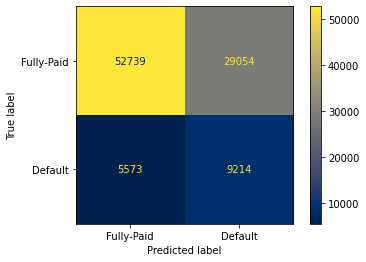

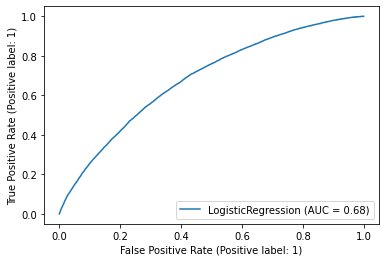

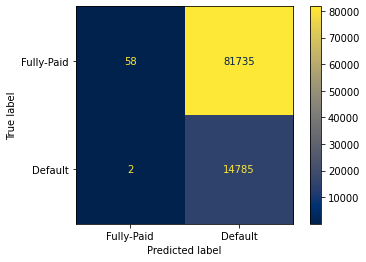

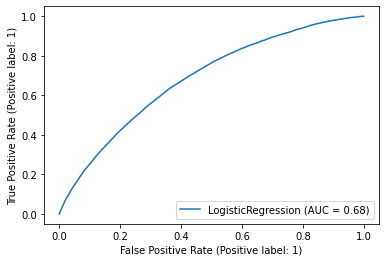

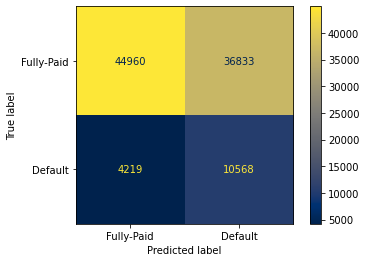

...

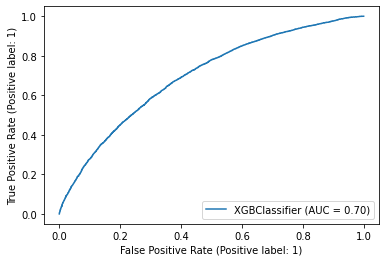

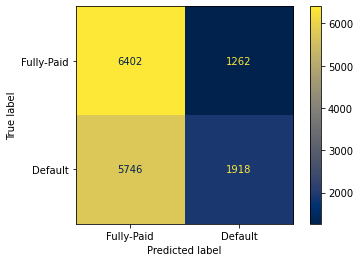

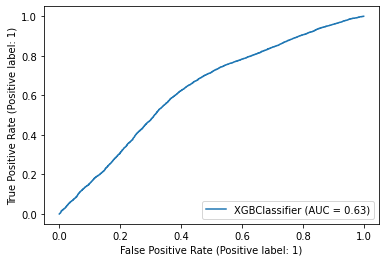

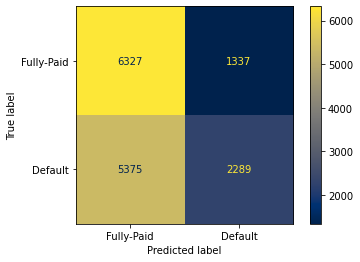

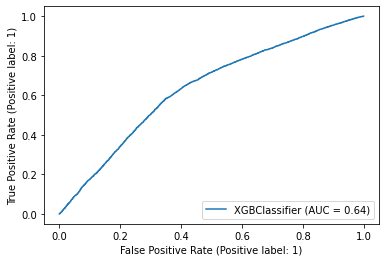

In [54]:
master_out = master_func_eval(clf_list, clf_name_list, sampling_methods, scaling_methods,
                              target='default', year=year_list, thres=0.5, size=-1, show=False)

#### ~ REDUCED OUTPUT ~

In [29]:
# load previous master output table
master_out = pd.read_csv('master_output.csv', index_col=0)

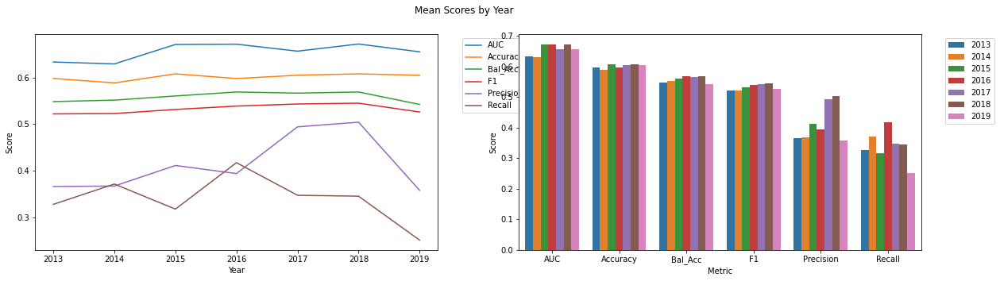

<Figure size 1440x1080 with 0 Axes>

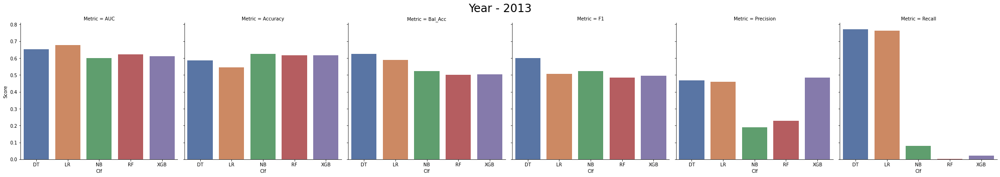

<Figure size 1440x1080 with 0 Axes>

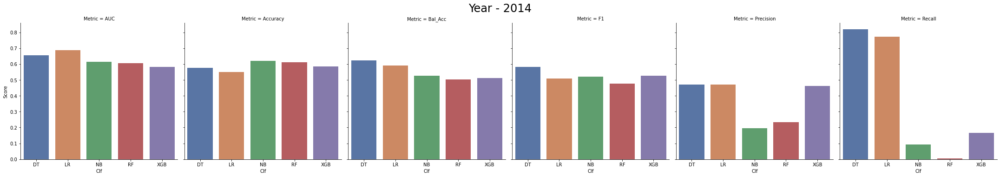

<Figure size 1440x1080 with 0 Axes>

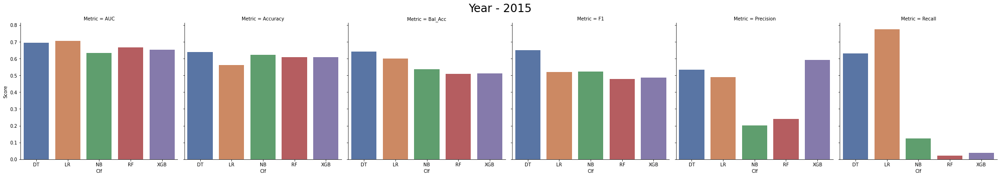

<Figure size 1440x1080 with 0 Axes>

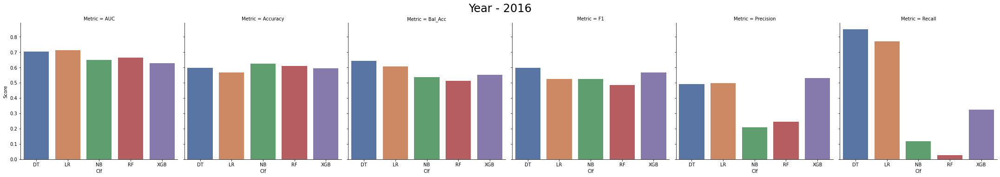

<Figure size 1440x1080 with 0 Axes>

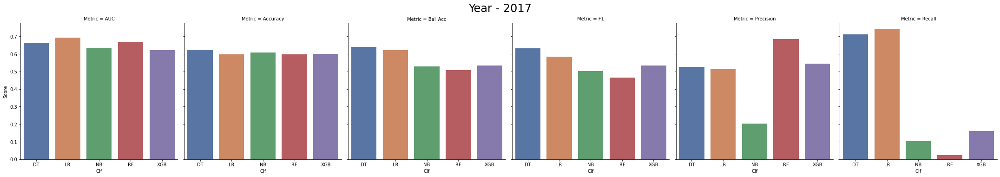

<Figure size 1440x1080 with 0 Axes>

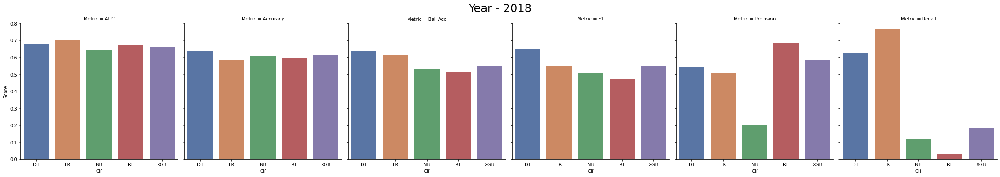

<Figure size 1440x1080 with 0 Axes>

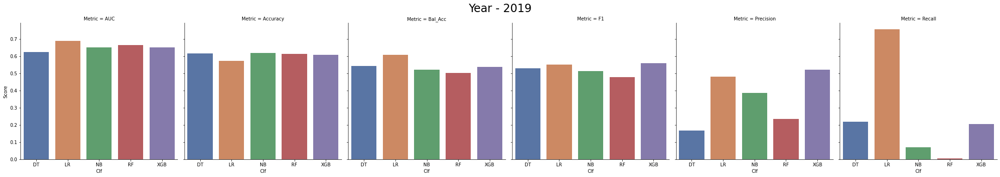

In [61]:
plot_all_yrs(master_out)

<Figure size 1440x1440 with 0 Axes>

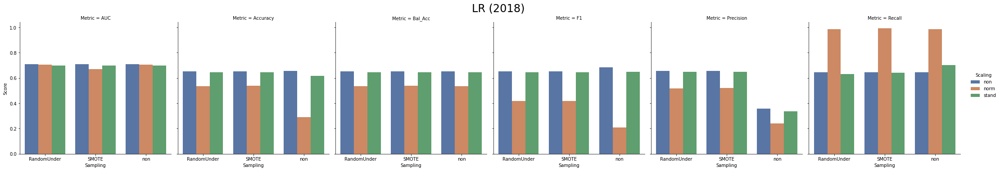

<Figure size 1440x1440 with 0 Axes>

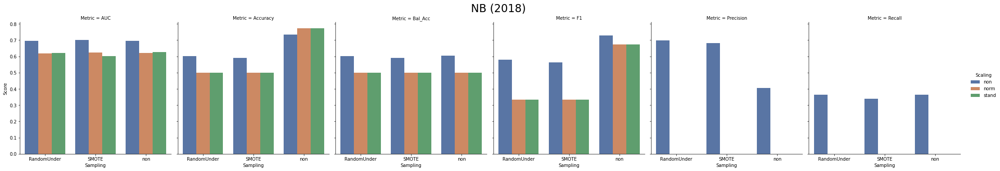

<Figure size 1440x1440 with 0 Axes>

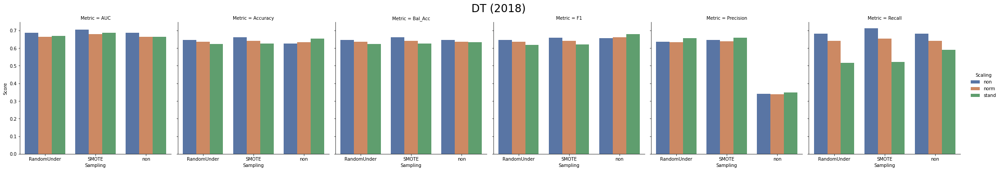

<Figure size 1440x1440 with 0 Axes>

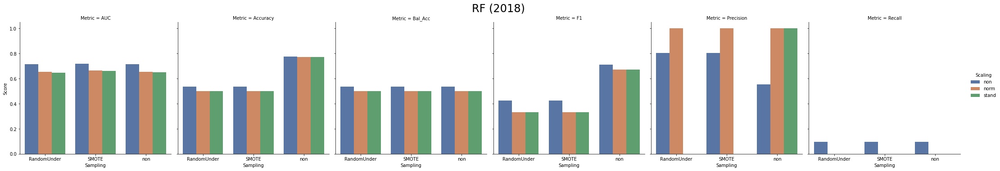

<Figure size 1440x1440 with 0 Axes>

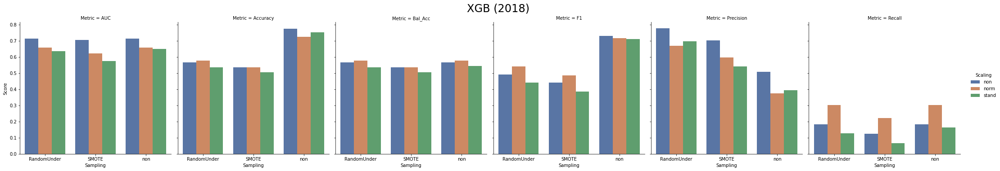

In [62]:
plot_one_yr(master_out, 2018)

In [30]:
# set heatmap style to red-yellow-green
master_out[master_out['Year']==2018].style.background_gradient(cmap ='RdYlGn')

,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC,Year,Clf,Scaling,Sampling
2018_LR,0:00:11.675400,0.656900,0.652800,0.359400,0.645200,0.682900,0.708000,2018,LR,non,non
2018_LR_norm,0:00:12.940393,0.289600,0.535200,0.241300,0.986500,0.207300,0.705200,2018,LR,norm,non
2018_LR_stand,0:00:11.840260,0.617200,0.646700,0.336800,0.700900,0.648000,0.697200,2018,LR,stand,non
2018_LR_SMOTE,0:00:14.650572,0.652700,0.652700,0.655100,0.645000,0.652700,0.710200,2018,LR,non,SMOTE
2018_LR_SMOTE_norm,0:00:15.580747,0.537700,0.537700,0.519800,0.991600,0.417800,0.669300,2018,LR,norm,SMOTE
2018_LR_SMOTE_stand,0:00:14.713413,0.646000,0.646000,0.647000,0.642700,0.646000,0.698800,2018,LR,stand,SMOTE
2018_LR_RandomUnder,0:00:11.506704,0.653000,0.653000,0.655500,0.645200,0.653000,0.708700,2018,LR,non,RandomUnder
2018_LR_RandomUnder_norm,0:00:12.499033,0.535400,0.535400,0.518600,0.986500,0.416800,0.704900,2018,LR,norm,RandomUnder
2018_LR_RandomUnder_stand,0:00:11.656782,0.645400,0.645400,0.649300,0.632500,0.645400,0.698400,2018,LR,stand,RandomUnder
2018_NB,0:00:11.542779,0.733400,0.603200,0.405600,0.363900,0.728200,0.695100,2018,NB,non,non


# 6) Manual Run

## a) Data Loading & Classifier Initialization

In [32]:
# load previous master output table
master_out = pd.read_csv('master_output.csv', index_col=0)

In [33]:
### SET PARAMETERS ###
year = 2018
size = -1
thres = 0.5
local_ex = 42    # index for local explainability example (SHAP)

In [34]:
# data loading and splitting
X_train_main, X_test_main, y_train_main, y_test_main = load_and_split_data('Data/data_clean_full.csv', 'default', size=-1, year=[year])

In [35]:
X_train_main.head()

,loan_amnt,term,int_rate,sub_grade,emp_length,annual_inc,dti,open_acc,revol_bal,revol_util,initial_list_status,pub_rec_bankruptcies,mort_acc,manager,fico,yrs_cr_line,home_ANY,home_MORTGAGE,home_NONE,home_OTHER,home_OWN,home_RENT,purp_CAR,purp_CREDIT_CARD,purp_DEBT_CONSOLIDATION,purp_EDUCATIONAL,purp_HOME_IMPROVEMENT,purp_HOUSE,purp_MAJOR_PURCHASE,purp_MEDICAL,purp_MOVING,purp_OTHER,purp_RENEWABLE_ENERGY,purp_SMALL_BUSINESS,purp_VACATION,purp_WEDDING,verification_NOT_VERIFIED,verification_SOURCE_VERIFIED,verification_VERIFIED,title_DIRECTOR,title_DRIVER,title_ENGINEER,title_GENERAL MANAGER,title_MANAGER,title_MISSING,title_OFFICE MANAGER,title_OTHER,title_OWNER,title_PRESIDENT,title_PROJECT MANAGER,title_REGISTERED NURSE,title_SALES,title_SUPERVISOR,title_TEACHER,title_TRUCK DRIVER,state_AK,state_AL,state_AR,state_AZ,state_CA,state_CO,state_CT,state_DC,state_DE,state_FL,state_GA,state_HI,state_IA,state_ID,state_IL,state_IN,state_KS,state_KY,state_LA,state_MA,state_MD,state_ME,state_MI,state_MN,state_MO,state_MS,state_MT,state_NC,state_ND,state_NE,state_NH,state_NJ,state_NM,state_NV,state_NY,state_OH,state_OK,state_OR,state_PA,state_RI,state_SC,state_SD,state_TN,state_TX,state_UT,state_VA,state_VT,state_WA,state_WI,state_WV,state_WY
326924,12000.0,0,7.97,5,15.0,155000.0,14.04,13.0,44572.0,55.4,0.0,0.0,4.0,1.0,692.0,20.0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
412641,5000.0,0,16.91,15,15.0,24618.0,13.07,3.0,3277.0,99.3,1.0,0.0,0.0,0.0,692.0,18.0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
317594,15000.0,1,12.62,11,2.0,107300.0,33.81,16.0,41869.0,42.1,1.0,0.0,3.0,0.0,747.0,27.0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
446980,12000.0,0,18.94,17,15.0,48000.0,36.40,12.0,5793.0,67.0,1.0,1.0,0.0,0.0,662.0,10.0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
373866,20000.0,1,14.07,13,7.0,70000.0,29.78,14.0,2278.0,3.5,1.0,0.0,0.0,0.0,787.0,9.0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [36]:
# initialize all classifiers
clf_lr = LogisticRegression(solver='lbfgs', class_weight='balanced', max_iter=800, random_state=42)
clf_dt = tree.DecisionTreeClassifier(criterion='gini', splitter='best', max_depth=3, 
                                     class_weight='balanced', random_state=42)
clf_nb = GaussianNB()
clf_rf = RandomForestClassifier(n_estimators=100, class_weight='balanced', random_state=42)
clf_xgb = XGBClassifier(objective='binary:logistic', use_label_encoder=False, random_state=42)

## b) Logistic Regression

#### Base Model

In [37]:
### SET PARAMETERS ###
clf_sel = clf_lr
clf_name = 'LR'

scaler, sampler = get_optimal_data(master_out, clf_name, year=year, metric='AUC')

In [38]:
# train/test selection - SELECT WHETHER balanced AND/OR norm/stand DATASET 
_X_train, _y_train, _X_test, _y_test = select_X_y(X_train_main, y_train_main, X_test_main, y_test_main, 
                                                  sampler=sampler, scaler=scaler, 
                                                  size=-1, sampling_strategy=1, 
                                                  version=0, n_neighbors=0)

In [39]:
# fit classifier
clf_fit = fit_model(_X_train, _y_train, clf_sel)

,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
LR_train,0:00:00.013921,0.6516,0.6473,0.3543,0.6395,0.678,0.7047
LR_test,0:00:00.084328,0.6527,0.6527,0.6551,0.645,0.6527,0.7102


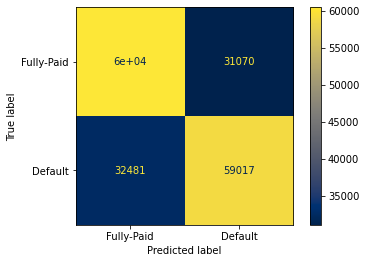

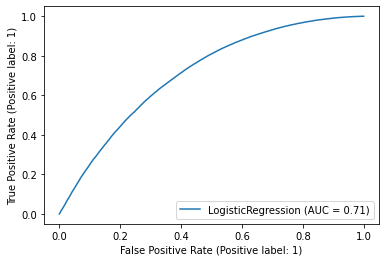

In [40]:
# full-pipeline function
model_eval = fit_pred_eval(_X_train, _y_train, _X_test, _y_test, clf_sel, clf_name, thres=thres)

#### Hyper-Parameter Tuning

In [41]:
### HYPER-PARAMETER DISTRIBUTIONS ###

# Logistic Regression
params = {"penalty": ['l2', 'l1'],
          'max_iter' : range(100, 500, 100),
          'warm_start' : [True, False],
          'solver' : ['lbfgs', 'newton-cg', 'liblinear'],
          'C' : np.arange(0, 1, 0.1)}

In [42]:
# random search tuning
best_clf, best_params, best_cv_results = random_search(_X_train, _y_train, clf_fit, 
                                                       params, n_iter=5, cv=3, 
                                                       k_fold=3, scoring='roc_auc')

In [44]:
best_clf

LogisticRegression(C=0.8, class_weight='balanced', penalty='l1',
                   random_state=42, solver='liblinear', warm_start=True)

In [71]:
print(best_params)
#pprint(best_params)

{'warm_start': True, 'solver': 'liblinear', 'penalty': 'l1', 'max_iter': 100, 'C': 0.8}


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
LR_best_train,0:00:00.163662,0.7162,0.7162,0.6478,0.9476,0.7001,0.919
LR_best_test,0:00:00.022006,0.5576,0.6526,0.3192,0.8273,0.5875,0.7246


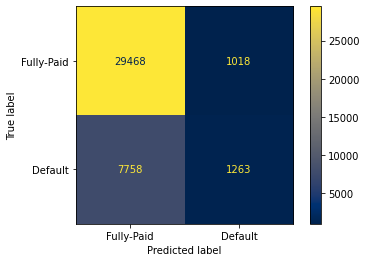

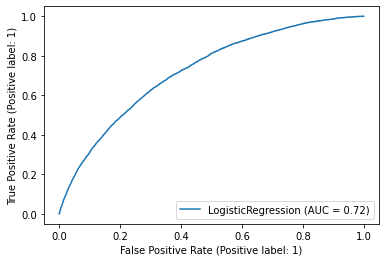

In [72]:
# get predictions and probabilities
y_pred_test, y_prob_test = predict(_X_test, best_clf, thres)

# model evaluation
model_eval, cm, roc = eval_model(_X_test, _y_test, _X_train, _y_train, best_clf, clf_name+'_best', thres=thres)

#### Optimal Classsifier Threshold

In [73]:
# threshold grid search
thres_grid = grid_search_thres(best_clf, _X_test, _y_test, step=0.05, show=True)

,0.00,0.05,0.10,0.15,0.20,0.25,0.30,0.35,0.40,0.45,0.50,0.55,0.60,0.65,0.70,0.75,0.80,0.85,0.90,0.95
Accuracy,0.2283,0.2633,0.3939,0.5226,0.6126,0.6790,0.7230,0.7519,0.7685,0.7768,0.7779,0.7770,0.7758,0.7747,0.7734,0.7725,0.7720,0.7718,0.7717,0.7717
Balanced Acc,0.5000,0.5211,0.5900,0.6427,0.6593,0.6629,0.6463,0.6253,0.6014,0.5763,0.5533,0.5351,0.5219,0.5131,0.5064,0.5030,0.5011,0.5004,0.5001,0.5000
Precision,0.2283,0.2361,0.2674,0.3065,0.3408,0.3787,0.4129,0.4504,0.4885,0.5290,0.5537,0.5753,0.5998,0.6339,0.6700,0.6966,0.6970,0.7273,1.0000,0.0000
Recall,1.0000,0.9956,0.9509,0.8638,0.7454,0.6333,0.5053,0.3921,0.2939,0.2073,0.1400,0.0898,0.0547,0.0315,0.0151,0.0069,0.0025,0.0009,0.0002,0.0000
F1,0.0849,0.1557,0.3796,0.5484,0.6435,0.7017,0.7322,0.7457,0.7461,0.7373,0.7227,0.7080,0.6957,0.6866,0.6794,0.6756,0.6735,0.6726,0.6723,0.6722
AUC,0.7246,0.7246,0.7246,0.7246,0.7246,0.7246,0.7246,0.7246,0.7246,0.7246,0.7246,0.7246,0.7246,0.7246,0.7246,0.7246,0.7246,0.7246,0.7246,0.7246


Optimal Threshold: 0.2275


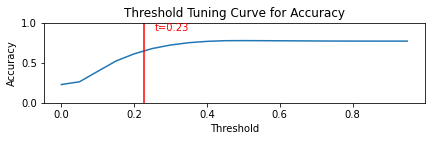

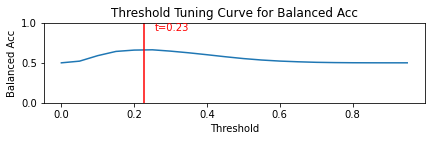

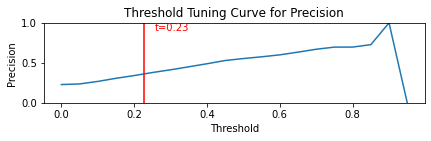

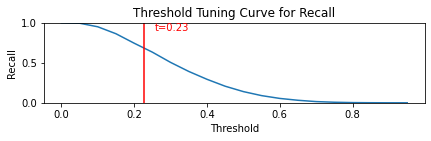

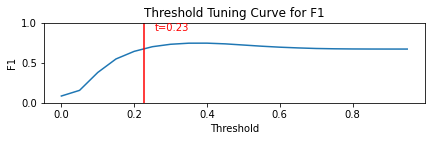

In [74]:
# plot threshold tuning curve
plot_thres(best_clf, _X_test, _y_test, step=0.05, metric=None)

In [75]:
# calculate optimal threshold
get_opt_thres(best_clf, _X_test, _y_test)

Optimal Threshold: 0.2275


0.2274930303296835

In [76]:
# set threshold
thres = get_opt_thres(best_clf, _X_test, _y_test)

Optimal Threshold: 0.2275


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
LR_best_optThres_train,0:00:00.109444,0.7776,0.7776,0.7206,0.9067,0.7738,0.919
LR_best_optThres_test,0:00:00.022603,0.6537,0.6652,0.3633,0.6865,0.6807,0.7246


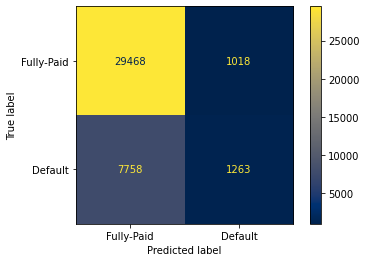

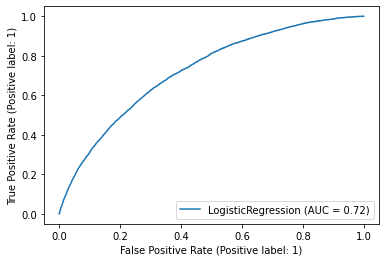

In [77]:
# get predictions and probabilities
y_pred_test, y_prob_test = predict(_X_test, best_clf, thres)

# model evaluation
model_eval, cm, roc = eval_model(_X_test, _y_test, _X_train, _y_train, best_clf, clf_name+'_best_optThres', thres=thres)

### XAI Plots

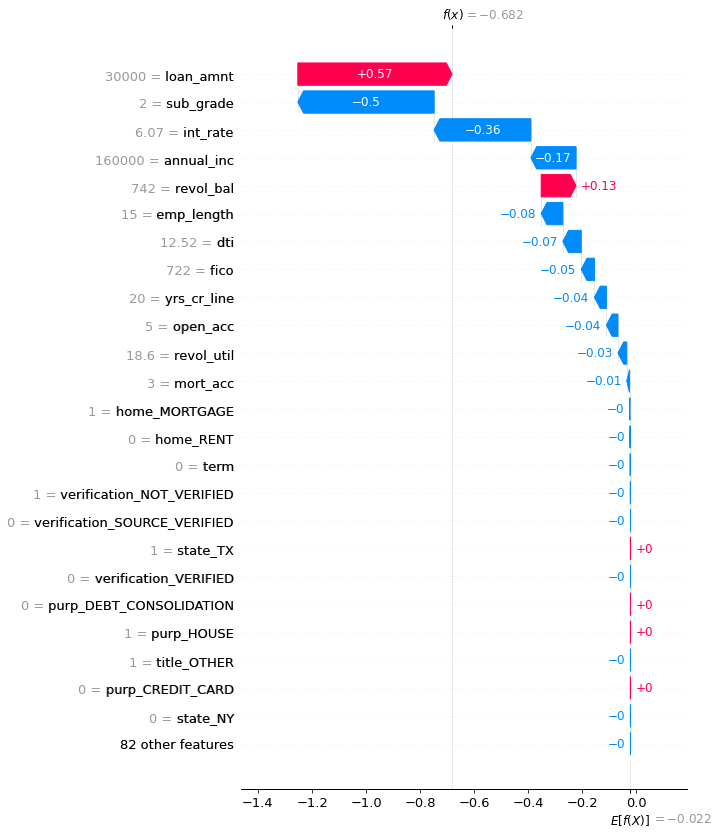

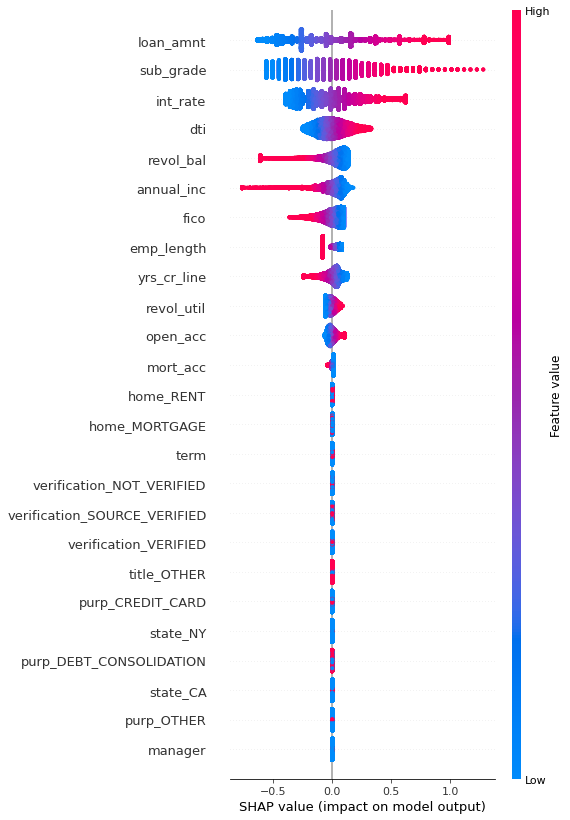

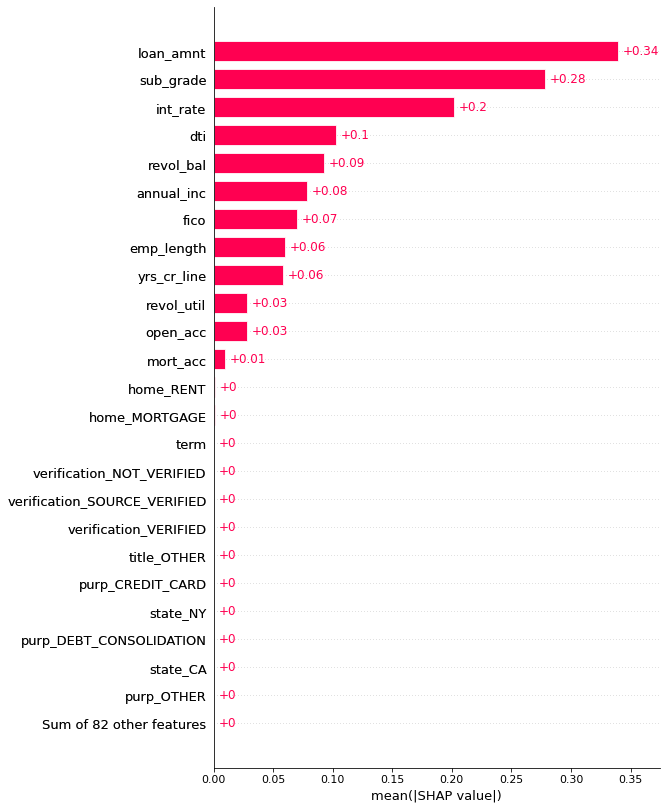

In [78]:
# SHAP charts
shap_values = run_shap(clf_fit, _X_test, local_ex)

In [43]:
# LIME charts
run_lime(_X_train, _X_test, clf_fit)

In [80]:
# PFI charts
run_pfi(_X_test, _y_test, clf_fit)

Weight,Feature
0.0278 ± 0.0013,loan_amnt
0.0136 ± 0.0037,sub_grade
0.0035 ± 0.0023,int_rate
0.0026 ± 0.0018,revol_bal
0.0016 ± 0.0017,annual_inc
0.0009 ± 0.0013,emp_length
0.0004 ± 0.0012,yrs_cr_line
0.0001 ± 0.0008,open_acc
0.0000 ± 0.0000,purp_DEBT_CONSOLIDATION
0.0000 ± 0.0006,mort_acc


In [81]:
# pickle model
pickle_model(clf_fit, clf_name+'_'+datetime.now(pytz.timezone('US/Pacific')).strftime("%d-%m-%Y_%H-%M"))

'Model saved as: LR_11-01-2023_12-37'

## c) Naive Bayes

#### Base Model

In [41]:
### SET PARAMETERS ###
clf_sel = clf_nb
clf_name = 'NB'

scaler, sampler = get_optimal_data(master_out, clf_name, year=year, metric='AUC')

In [42]:
# train/test selection - SELECT WHETHER balanced AND/OR norm/stand DATASET 
_X_train, _y_train, _X_test, _y_test = select_X_y(X_train_main, y_train_main, X_test_main, y_test_main, 
                                                  sampler=sampler, scaler=scaler, 
                                                  size=-1, sampling_strategy=1, 
                                                  version=0, n_neighbors=0)

In [43]:
# fit classifier
clf_fit = fit_model(_X_train, _y_train, clf_sel)

,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
NB_train,0:00:00.073628,0.7316,0.6025,0.4031,0.3649,0.7268,0.6915
NB_test,0:00:00.453485,0.5902,0.5902,0.6821,0.3379,0.5623,0.7021


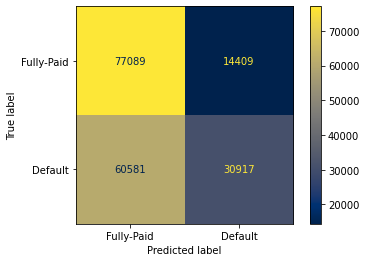

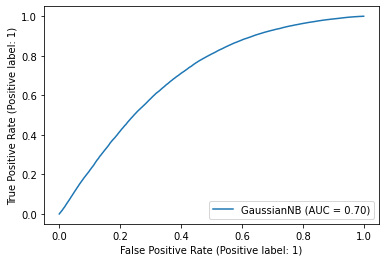

In [44]:
# full-pipeline function
model_eval = fit_pred_eval(_X_train, _y_train, _X_test, _y_test, clf_sel, clf_name, thres=thres)

#### Optimal Classsifier Threshold

In [45]:
# threshold grid search
thres_grid = grid_search_thres(clf_fit, _X_test, _y_test, step=0.05, show=True)

,0.00,0.05,0.10,0.15,0.20,0.25,0.30,0.35,0.40,0.45,0.50,0.55,0.60,0.65,0.70,0.75,0.80,0.85,0.90,0.95
Accuracy,0.2283,0.4101,0.5068,0.5666,0.6089,0.6408,0.6668,0.6881,0.7068,0.7204,0.7316,0.7420,0.7490,0.7553,0.7604,0.7655,0.7674,0.7701,0.7716,0.7723
Balanced Acc,0.5000,0.5901,0.6255,0.6389,0.6409,0.6387,0.6350,0.6300,0.6236,0.6131,0.6025,0.5932,0.5817,0.5701,0.5591,0.5501,0.5371,0.5275,0.5169,0.5049
Precision,0.2283,0.2689,0.2964,0.3161,0.3313,0.3445,0.3576,0.3705,0.3841,0.3936,0.4031,0.4155,0.4234,0.4323,0.4422,0.4594,0.4622,0.4799,0.4988,0.5610
Recall,1.0000,0.9213,0.8439,0.7719,0.6999,0.6350,0.5765,0.5231,0.4706,0.4158,0.3649,0.3194,0.2737,0.2291,0.1884,0.1538,0.1132,0.0809,0.0480,0.0127
F1,0.0849,0.4066,0.5325,0.5987,0.6403,0.6684,0.6892,0.7046,0.7166,0.7230,0.7268,0.7294,0.7283,0.7257,0.7216,0.7175,0.7086,0.7009,0.6909,0.6779
AUC,0.6915,0.6915,0.6915,0.6915,0.6915,0.6915,0.6915,0.6915,0.6915,0.6915,0.6915,0.6915,0.6915,0.6915,0.6915,0.6915,0.6915,0.6915,0.6915,0.6915


Optimal Threshold: 0.1675


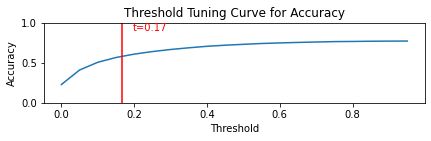

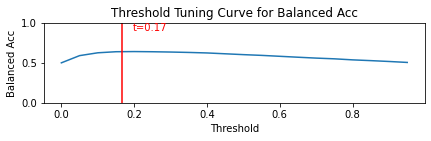

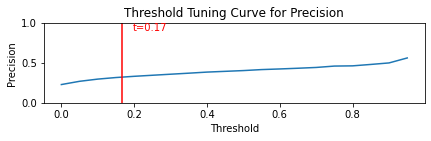

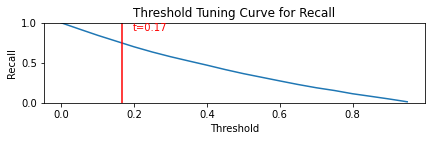

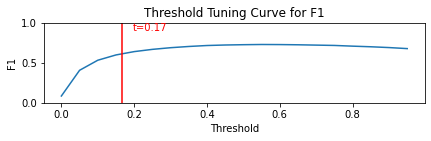

In [46]:
# plot threshold tuning curve
plot_thres(clf_fit, _X_test, _y_test, step=0.05, metric=None)

In [47]:
# calculate optimal threshold
get_opt_thres(clf_fit, _X_test, _y_test)

Optimal Threshold: 0.1675


0.16746000302901665

In [48]:
# set threshold
thres = get_opt_thres(clf_fit, _X_test, _y_test)

Optimal Threshold: 0.1675


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
NB_optThres_train,0:00:00.490571,0.6575,0.6575,0.6279,0.7733,0.6529,0.7021
NB_optThres_test,0:00:00.069458,0.5829,0.6414,0.3222,0.749,0.6151,0.6915


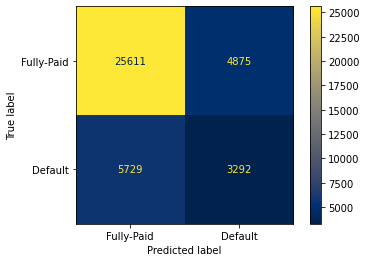

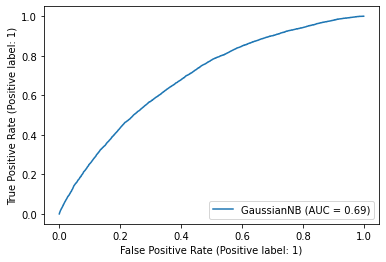

In [49]:
# get predictions and probabilities
y_pred_test, y_prob_test = predict(_X_test, clf_fit, thres)

# model evaluation
model_eval, cm, roc = eval_model(_X_test, _y_test, _X_train, _y_train, clf_fit, clf_name+'_optThres', thres=thres)

In [50]:
# LIME charts
run_lime(_X_train, _X_test, clf_fit)

In [51]:
# PFI charts
run_pfi(_X_test, _y_test, clf_fit)

Weight,Feature
0.0092 ± 0.0018,loan_amnt
0.0003 ± 0.0009,mort_acc
0.0003 ± 0.0005,term
0.0003 ± 0.0003,emp_length
0.0002 ± 0.0001,title_OTHER
0.0002 ± 0.0003,home_MORTGAGE
0.0001 ± 0.0006,home_RENT
0.0001 ± 0.0002,verification_SOURCE_VERIFIED
0.0001 ± 0.0001,state_TX
0.0001 ± 0.0001,pub_rec_bankruptcies


In [52]:
# pickle model
pickle_model(clf_fit, clf_name+'_'+datetime.now(pytz.timezone('US/Pacific')).strftime("%d-%m-%Y_%H-%M"))

'Model saved as: NB_11-01-2023_12-11'

## d) Decision Tree

#### Base Model

In [124]:
### SET PARAMETERS ###
clf_sel = clf_dt
clf_name = 'DT'

scaler, sampler = get_optimal_data(master_out, clf_name, year=year, metric='AUC')

In [125]:
# train/test selection - SELECT WHETHER balanced AND/OR norm/stand DATASET 
_X_train, _y_train, _X_test, _y_test = select_X_y(X_train_main, y_train_main, X_test_main, y_test_main, 
                                                  sampler=sampler, scaler=scaler, 
                                                  size=-1, sampling_strategy=1, 
                                                  version=0, n_neighbors=0)

In [126]:
# fit classifier
clf_fit = fit_model(_X_train, _y_train, clf_sel)

In [127]:
clf_fit

DecisionTreeClassifier(class_weight='balanced', max_depth=3, random_state=42)

,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
DT_train,0:00:00.024619,0.4111,0.5943,0.2706,0.9313,0.4065,0.6888
DT_test,0:00:00.108466,0.601,0.601,0.5599,0.9443,0.5477,0.7045


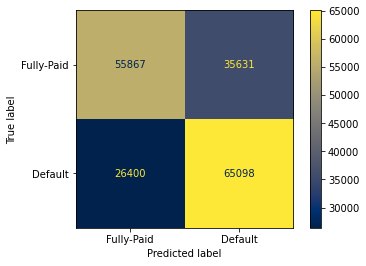

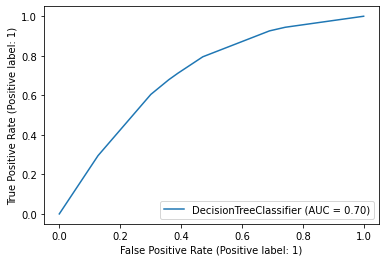

In [128]:
# full-pipeline function
model_eval = fit_pred_eval(_X_train, _y_train, _X_test, _y_test, clf_sel, clf_name, thres=thres)

#### Hyper-Parameter Tuning

In [140]:
### HYPER-PARAMETER DISTRIBUTIONS ###

# Decision Tree
params = {"max_depth": range(2, 10),
          "max_features": range(1, _X_train.shape[1]),
          #"min_samples_leaf": np.linspace(0.1, 0.5, 5, endpoint=True),
          "criterion": ["gini", "entropy"]}

In [141]:
# random search tuning
best_clf, best_params, best_cv_results = random_search(_X_train, _y_train, clf_fit, 
                                                       params, n_iter=5, cv=3, 
                                                       k_fold=3, scoring='roc_auc')

In [142]:
best_clf

DecisionTreeClassifier(class_weight='balanced', criterion='entropy',
                       max_depth=7, max_features=95, random_state=42)

In [143]:
print(best_params)
#pprint(best_params)

{'max_features': 95, 'max_depth': 7, 'criterion': 'entropy'}


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
DT_best_train,0:00:00.119251,0.6942,0.6942,0.6317,0.9315,0.6759,0.8744
DT_best_test,0:00:00.029642,0.5332,0.6345,0.3056,0.8209,0.5624,0.6885


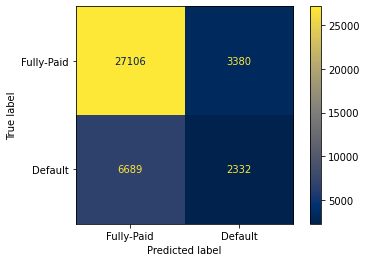

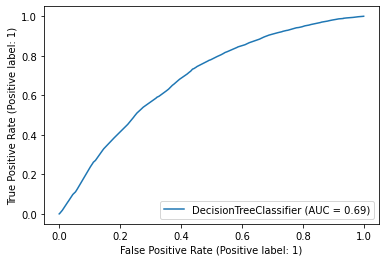

In [144]:
# get predictions and probabilities
y_pred_test, y_prob_test = predict(_X_test, best_clf, thres)

# model evaluation
model_eval, cm, roc = eval_model(_X_test, _y_test, _X_train, _y_train, best_clf, clf_name+'_best', thres=thres)

#### Optimal Classsifier Threshold

In [145]:
# threshold grid search
thres_grid = grid_search_thres(best_clf, _X_test, _y_test, step=0.05, show=True)

,0.00,0.05,0.10,0.15,0.20,0.25,0.30,0.35,0.40,0.45,0.50,0.55,0.60,0.65,0.70,0.75,0.80,0.85,0.90,0.95
Accuracy,0.2283,0.2774,0.3308,0.4493,0.4661,0.5696,0.6091,0.6548,0.6851,0.6950,0.7452,0.7548,0.7635,0.7635,0.7636,0.7716,0.7716,0.7716,0.7716,0.7716
Balanced Acc,0.5000,0.5280,0.5552,0.6087,0.6133,0.6425,0.6438,0.6338,0.6305,0.6223,0.5741,0.5332,0.5169,0.5169,0.5169,0.5000,0.5000,0.5000,0.5000,0.5000
Precision,0.2283,0.2388,0.2504,0.2805,0.2846,0.3186,0.3327,0.3497,0.3683,0.3721,0.4086,0.3862,0.3897,0.3897,0.3900,0.0000,0.0000,0.0000,0.0000,0.0000
Recall,1.0000,0.9892,0.9682,0.9020,0.8840,0.7767,0.7077,0.5952,0.5300,0.4884,0.2591,0.1252,0.0629,0.0629,0.0629,0.0000,0.0000,0.0000,0.0000,0.0000
F1,0.0849,0.1841,0.2814,0.4597,0.4822,0.6015,0.6405,0.6796,0.7025,0.7082,0.7232,0.7034,0.6912,0.6912,0.6912,0.6722,0.6722,0.6722,0.6722,0.6722
AUC,0.6885,0.6885,0.6885,0.6885,0.6885,0.6885,0.6885,0.6885,0.6885,0.6885,0.6885,0.6885,0.6885,0.6885,0.6885,0.6885,0.6885,0.6885,0.6885,0.6885


Optimal Threshold: 0.2677


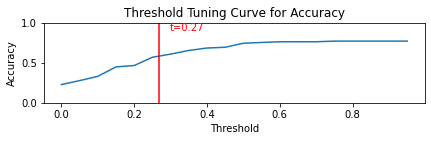

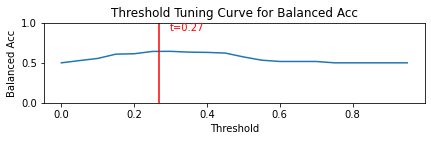

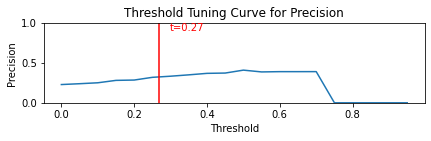

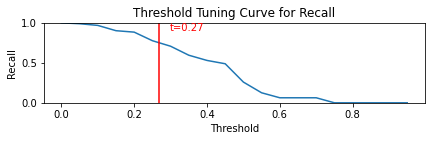

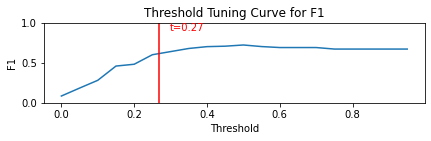

In [146]:
# plot threshold tuning curve
plot_thres(best_clf, _X_test, _y_test, step=0.05, metric=None)

In [147]:
# calculate optimal threshold
get_opt_thres(best_clf, _X_test, _y_test)

Optimal Threshold: 0.2677


0.2676923076923077

In [148]:
# set threshold
thres = get_opt_thres(best_clf, _X_test, _y_test)

Optimal Threshold: 0.2677


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
DT_best_optThres_train,0:00:00.115127,0.731,0.731,0.6741,0.8947,0.7236,0.8744
DT_best_optThres_test,0:00:00.026093,0.601,0.6474,0.3311,0.7327,0.6327,0.6885


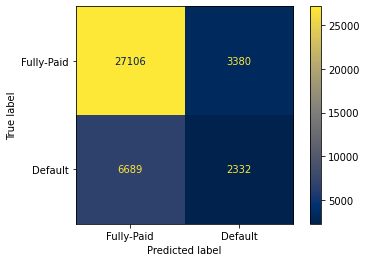

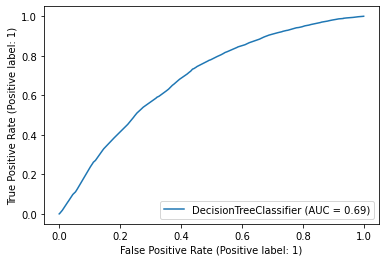

In [149]:
# get predictions and probabilities
y_pred_test, y_prob_test = predict(_X_test, best_clf, thres)

# model evaluation
model_eval, cm, roc = eval_model(_X_test, _y_test, _X_train, _y_train, best_clf, clf_name+'_best_optThres', thres=thres)

### XAI Plots

In [150]:
# LIME charts
run_lime(_X_train, _X_test, best_clf)

In [151]:
# PFI charts
run_pfi(_X_test, _y_test, best_clf)

Weight,Feature
0.1069 ± 0.0020,verification_NOT_VERIFIED
0.0928 ± 0.0021,home_MORTGAGE
0.0808 ± 0.0016,verification_SOURCE_VERIFIED
0.0664 ± 0.0018,home_RENT
0.0508 ± 0.0014,int_rate
0.0395 ± 0.0007,home_OWN
0.0256 ± 0.0008,verification_VERIFIED
0.0144 ± 0.0006,sub_grade
0.0064 ± 0.0015,purp_DEBT_CONSOLIDATION
0.0035 ± 0.0008,loan_amnt


In [152]:
# pickle model
pickle_model(best_clf, clf_name+'_'+datetime.now(pytz.timezone('US/Pacific')).strftime("%d-%m-%Y_%H-%M"))

'Model saved as: DT_11-01-2023_12-57'

## e) XGBoost

#### Base Model

In [108]:
### SET PARAMETERS ###
clf_sel = clf_xgb
clf_name = 'XGB'

scaler, sampler = get_optimal_data(master_out, clf_name, year=year, metric='AUC')

In [109]:
# train/test selection - SELECT WHETHER balanced AND/OR norm/stand DATASET 
_X_train, _y_train, _X_test, _y_test = select_X_y(X_train_main, y_train_main, X_test_main, y_test_main, 
                                                  sampler=sampler, scaler=scaler, 
                                                  size=-1, sampling_strategy=1, 
                                                  version=0, n_neighbors=0)

In [110]:
# fit classifier
clf_fit = fit_model(_X_train, _y_train, clf_sel)

,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
XGB_train,0:00:00.085093,0.667,0.7605,0.4014,0.9326,0.6928,0.8908
XGB_test,0:00:00.105826,0.6529,0.6529,0.6227,0.7761,0.6476,0.714


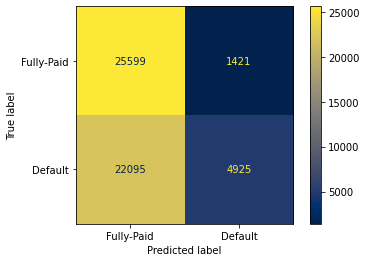

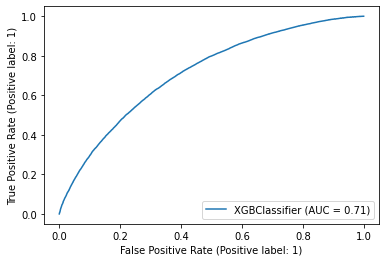

In [111]:
# full-pipeline function
model_eval = fit_pred_eval(_X_train, _y_train, _X_test, _y_test, clf_sel, clf_name, thres=thres)

#### Hyper-Parameter Tuning

In [112]:
### HYPER-PARAMETER DISTRIBUTIONS ###

# XGBoost
params = {'learning_rate': [0.001, 0.01, 0.05, 0.1, 0.2, 0.3],
          'n_estimators': [100, 200, 400, 800, 1000],
          'scale_pos_weight': [1, 2, 3, 4],
          'max_depth': [3, 4, 5, 6, 7, 8, 9, 10],
          'gamma': [0, 0.01, 0.1, 0.5, 1, 2],
          'min_child_weight': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
          'colsample_bytree': [0.8, 0.9, 1]}

In [113]:
# random search tuning
best_clf, best_params, best_cv_results = random_search(_X_train, _y_train, clf_fit, 
                                                       params, n_iter=5, cv=3, 
                                                       k_fold=3, scoring='roc_auc')

In [114]:
best_clf

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, gamma=0.5, gpu_id=-1, grow_policy='depthwise',
              importance_type=None, interaction_constraints='',
              learning_rate=0.01, max_bin=256, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=9, max_leaves=0, min_child_weight=4,
              missing=nan, monotone_constraints='()', n_estimators=200,
              n_jobs=0, num_parallel_tree=1, predictor='auto', random_state=42,
              reg_alpha=0, reg_lambda=1, ...)

In [115]:
print(best_params)
#pprint(best_params)

{'scale_pos_weight': 4, 'n_estimators': 200, 'min_child_weight': 4, 'max_depth': 9, 'learning_rate': 0.01, 'gamma': 0.5, 'colsample_bytree': 1}


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
XGB_best_train,0:00:00.170877,0.5025,0.5025,0.5012,1.0,0.3388,0.8045
XGB_best_test,0:00:00.127734,0.2313,0.5019,0.229,0.9999,0.091,0.7194


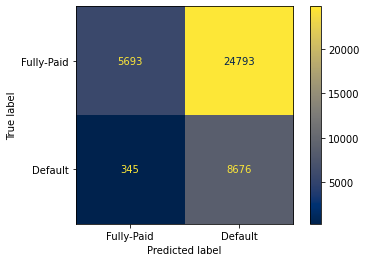

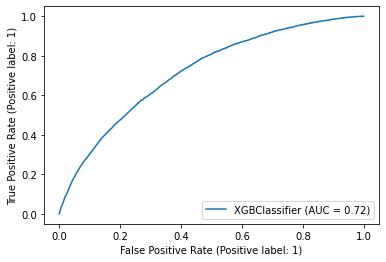

In [116]:
# get predictions and probabilities
y_pred_test, y_prob_test = predict(_X_test, best_clf, thres)

# model evaluation
model_eval, cm, roc = eval_model(_X_test, _y_test, _X_train, _y_train, best_clf, clf_name+'_best', thres=thres)

#### Optimal Classsifier Threshold

In [117]:
# threshold grid search
thres_grid = grid_search_thres(best_clf, _X_test, _y_test, step=0.05, show=True)

,0.00,0.05,0.10,0.15,0.20,0.25,0.30,0.35,0.40,0.45,0.50,0.55,0.60,0.65,0.70,0.75,0.80,0.85,0.90,0.95
Accuracy,0.2283,0.2283,0.2283,0.2300,0.2355,0.2446,0.2601,0.2800,0.3038,0.3318,0.3637,0.4006,0.4503,0.5069,0.5707,0.6405,0.7135,0.7743,0.7726,0.7717
Balanced Acc,0.5000,0.5000,0.5000,0.5011,0.5043,0.5100,0.5191,0.5304,0.5433,0.5582,0.5742,0.5916,0.6134,0.6350,0.6541,0.6608,0.6436,0.5806,0.5031,0.5000
Precision,0.2283,0.2283,0.2283,0.2287,0.2299,0.2319,0.2353,0.2397,0.2450,0.2515,0.2592,0.2686,0.2824,0.3002,0.3236,0.3543,0.4008,0.5131,0.6957,0.0000
Recall,1.0000,1.0000,1.0000,1.0000,0.9991,0.9983,0.9957,0.9911,0.9841,0.9748,0.9618,0.9432,0.9136,0.8706,0.8077,0.6981,0.5150,0.2243,0.0071,0.0000
F1,0.0849,0.0849,0.0849,0.0883,0.0998,0.1185,0.1497,0.1883,0.2324,0.2814,0.3338,0.3902,0.4596,0.5306,0.6015,0.6691,0.7250,0.7387,0.6757,0.6722
AUC,0.7194,0.7194,0.7194,0.7194,0.7194,0.7194,0.7194,0.7194,0.7194,0.7194,0.7194,0.7194,0.7194,0.7194,0.7194,0.7194,0.7194,0.7194,0.7194,0.7194


Optimal Threshold: 0.7406


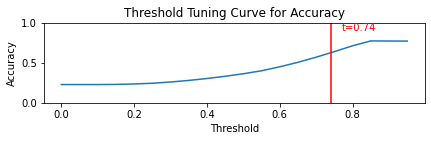

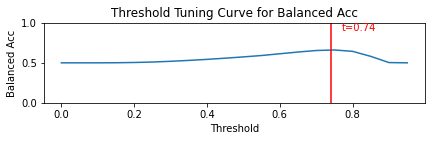

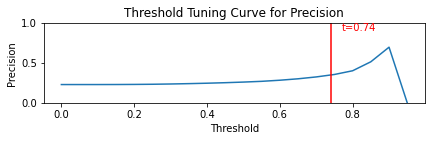

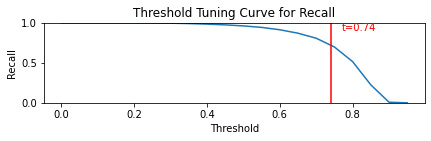

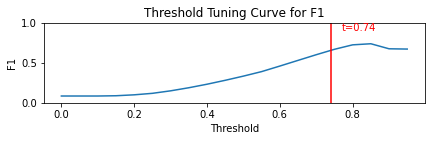

In [118]:
# plot threshold tuning curve
plot_thres(best_clf, _X_test, _y_test, step=0.05, metric=None)

In [119]:
# calculate optimal threshold
get_opt_thres(best_clf, _X_test, _y_test)

Optimal Threshold: 0.7406


0.7406454

In [120]:
# set threshold
thres = get_opt_thres(best_clf, _X_test, _y_test)

Optimal Threshold: 0.7406


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
XGB_best_optThres_train,0:00:00.167456,0.7231,0.7231,0.6981,0.7864,0.722,0.8045
XGB_best_optThres_test,0:00:00.123564,0.6275,0.6615,0.3482,0.7242,0.6574,0.7194


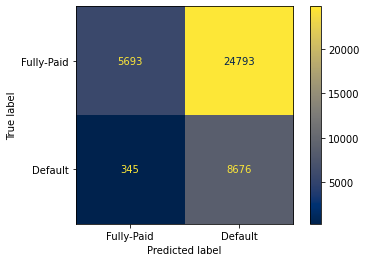

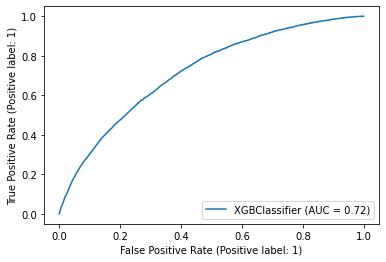

In [121]:
# get predictions and probabilities
y_pred_test, y_prob_test = predict(_X_test, best_clf, thres)

# model evaluation
model_eval, cm, roc = eval_model(_X_test, _y_test, _X_train, _y_train, best_clf, clf_name+'_best_optThres', thres=thres)

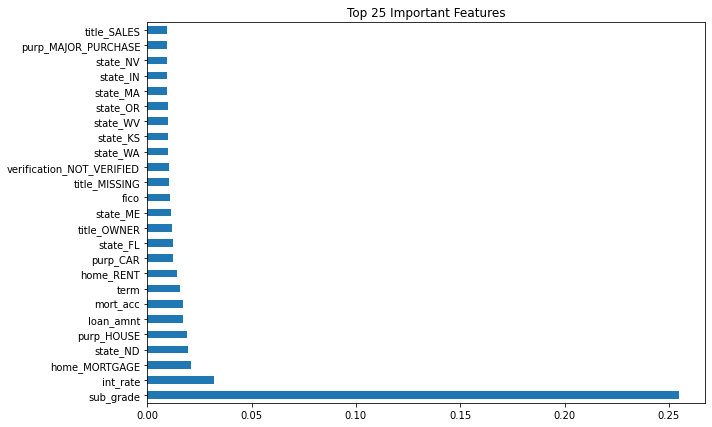

In [122]:
# XBGoost built-in Feature Importance
feat_importances = pd.Series(best_clf.feature_importances_, index=_X_train.columns)
feat_importances.nlargest(25).plot(kind='barh', figsize=(10,7))
plt.title("Top 25 Important Features")
plt.show()

### XAI Plots

100%|===================| 39467/39507 [17:33<00:01]        

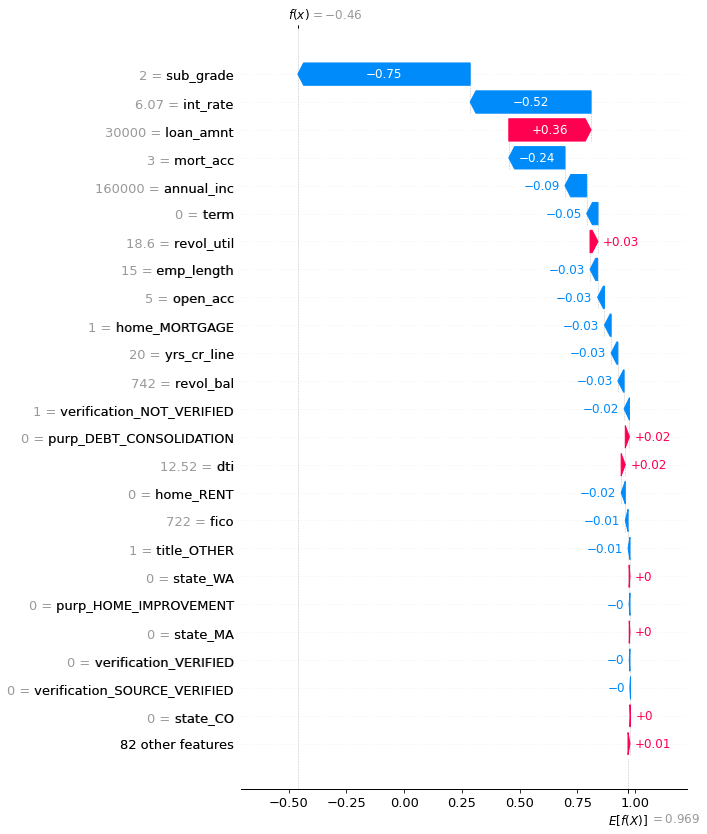

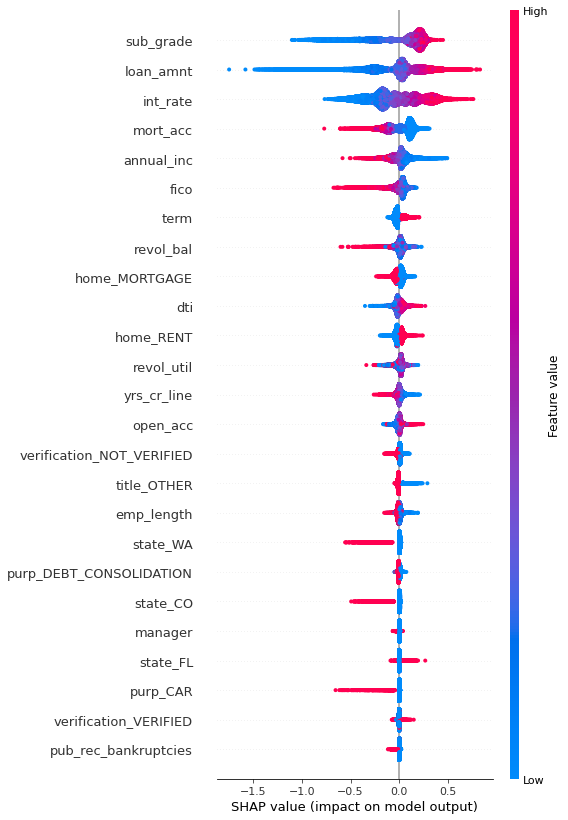

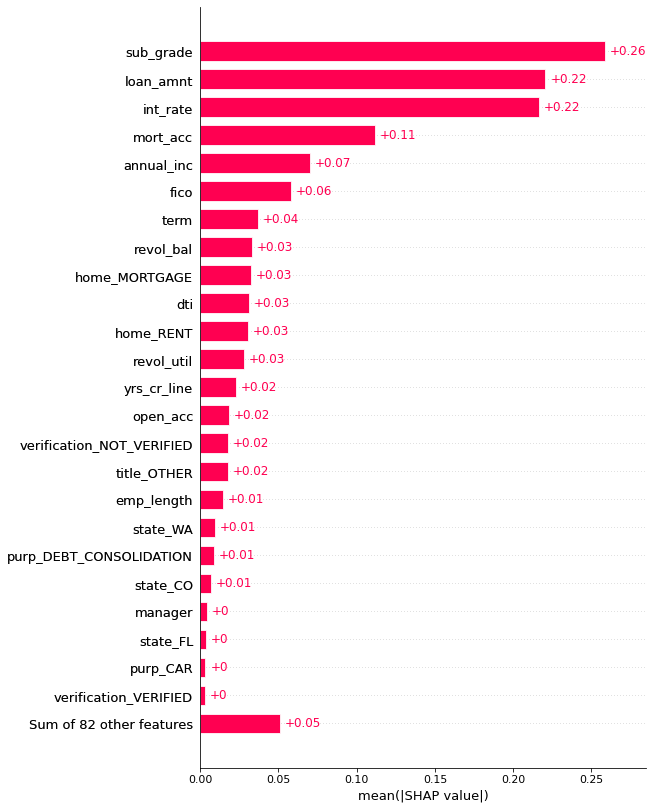

In [123]:
# SHAP charts
shap_values = run_shap(best_clf, _X_test, local_ex)

In [124]:
# LIME charts
run_lime(_X_train, _X_test, best_clf, local_ex)

In [125]:
# PFI charts
run_pfi(_X_test, _y_test, best_clf)

Weight,Feature
0.0616 ± 0.0013,sub_grade
0.0412 ± 0.0021,int_rate
0.0129 ± 0.0013,fico
0.0064 ± 0.0011,mort_acc
0.0043 ± 0.0022,loan_amnt
0.0038 ± 0.0008,term
0.0017 ± 0.0004,yrs_cr_line
0.0011 ± 0.0005,home_MORTGAGE
0.0009 ± 0.0013,revol_util
0.0008 ± 0.0002,purp_CAR


In [126]:
# pickle model
pickle_model(best_clf, clf_name+'_'+datetime.now(pytz.timezone('US/Pacific')).strftime("%d-%m-%Y_%H-%M"))

'Model saved as: XGB_11-01-2023_10-51'

## f) Random Forest

#### Base Model

In [37]:
### SET PARAMETERS ###
clf_sel = clf_rf
clf_name = 'RF'

scaler, sampler = get_optimal_data(master_out, clf_name, year=year, metric='AUC')

In [38]:
# train/test selection - SELECT WHETHER balanced AND/OR norm/stand DATASET 
_X_train, _y_train, _X_test, _y_test = select_X_y(X_train_main, y_train_main, X_test_main, y_test_main, 
                                                  sampler=sampler, scaler=scaler, 
                                                  size=-1, sampling_strategy=1, 
                                                  version=0, n_neighbors=0)

In [39]:
# fit classifier
clf_fit = fit_model(_X_train, _y_train, clf_sel)

,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
RF_train,0:00:01.547425,1.0,1.0,1.0,1.0,1.0,1.0
RF_test,0:00:06.541143,0.5358,0.5358,0.8043,0.0946,0.4236,0.7178


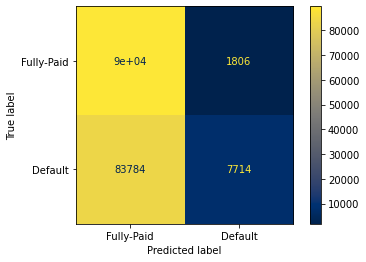

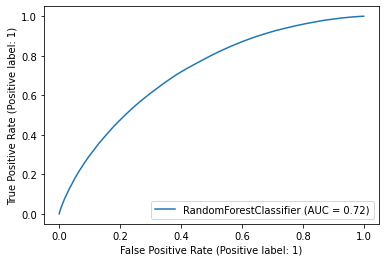

In [40]:
# full-pipeline function
model_eval = fit_pred_eval(_X_train, _y_train, _X_test, _y_test, clf_sel, clf_name, thres=thres)

#### Hyper-Parameter Tuning

In [41]:
### HYPER-PARAMETER DISTRIBUTIONS ###

# Random Forest
params = {'max_depth': [3, None],
          'max_features': sp_randint(1, 11),
          'min_samples_split': sp_randint(2, 11),
          'min_samples_leaf': sp_randint(1, 11),
          'bootstrap': [True, False],
          'criterion': ['gini', 'entropy']}

In [42]:
# random search tuning
best_clf, best_params, best_cv_results = random_search(_X_train, _y_train, clf_fit, 
                                                       params, n_iter=5, cv=3, 
                                                       k_fold=3, scoring='roc_auc')

In [43]:
best_clf

RandomForestClassifier(bootstrap=False, class_weight='balanced',
                       criterion='entropy', max_features=6, min_samples_leaf=2,
                       min_samples_split=6, random_state=42)

In [44]:
print(best_params)
#pprint(best_params)

{'bootstrap': False, 'criterion': 'entropy', 'max_depth': None, 'max_features': 6, 'min_samples_leaf': 2, 'min_samples_split': 6}


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
RF_best_train,0:00:06.764198,0.9686,0.9686,0.9998,0.9375,0.9686,0.9996
RF_best_test,0:00:01.777739,0.7753,0.5539,0.5284,0.1464,0.7225,0.7162


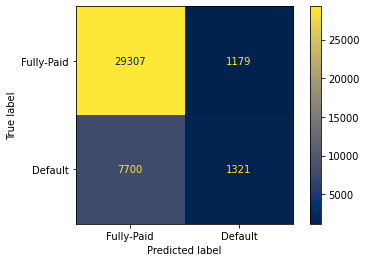

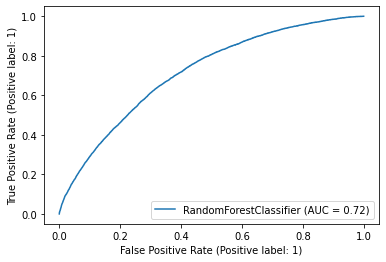

In [45]:
# get predictions and probabilities
y_pred_test, y_prob_test = predict(_X_test, best_clf, thres)

# model evaluation
model_eval, cm, roc = eval_model(_X_test, _y_test, _X_train, _y_train, best_clf, clf_name+'_best', thres=thres)

#### Optimal Classsifier Threshold

In [46]:
# threshold grid search
thres_grid = grid_search_thres(best_clf, _X_test, _y_test, step=0.05, show=True)

,0.00,0.05,0.10,0.15,0.20,0.25,0.30,0.35,0.40,0.45,0.50,0.55,0.60,0.65,0.70,0.75,0.80,0.85,0.90,0.95
Accuracy,0.2283,0.2542,0.3258,0.4154,0.5010,0.5845,0.6535,0.7055,0.7441,0.7659,0.7753,0.7774,0.7748,0.7734,0.7725,0.7719,0.7718,0.7717,0.7717,0.7717
Balanced Acc,0.5000,0.5156,0.5548,0.5992,0.6327,0.6572,0.6594,0.6430,0.6164,0.5842,0.5539,0.5312,0.5137,0.5056,0.5021,0.5006,0.5003,0.5001,0.5000,0.5000
Precision,0.2283,0.2340,0.2500,0.2729,0.2981,0.3294,0.3608,0.3924,0.4318,0.4761,0.5284,0.5949,0.6289,0.7143,0.8511,0.7857,1.0000,1.0000,0.0000,0.0000
Recall,1.0000,0.9967,0.9763,0.9376,0.8752,0.7910,0.6703,0.5278,0.3813,0.2498,0.1464,0.0782,0.0333,0.0127,0.0044,0.0012,0.0006,0.0001,0.0000,0.0000
F1,0.0849,0.1379,0.2713,0.4113,0.5236,0.6158,0.6803,0.7193,0.7384,0.7371,0.7225,0.7046,0.6873,0.6785,0.6745,0.6728,0.6725,0.6723,0.6722,0.6722
AUC,0.7162,0.7162,0.7162,0.7162,0.7162,0.7162,0.7162,0.7162,0.7162,0.7162,0.7162,0.7162,0.7162,0.7162,0.7162,0.7162,0.7162,0.7162,0.7162,0.7162


Optimal Threshold: 0.2724


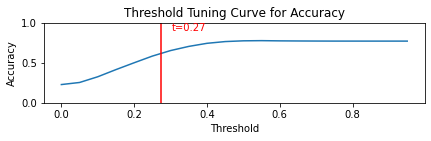

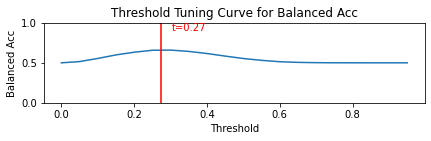

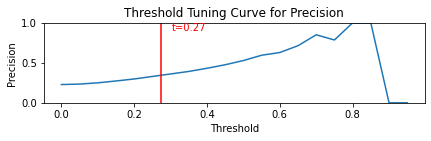

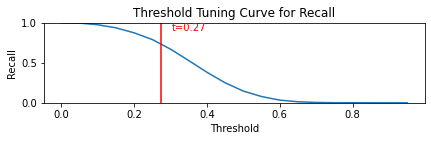

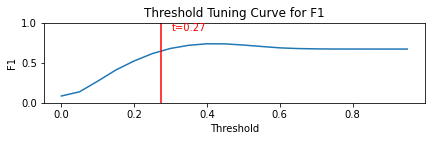

In [47]:
# plot threshold tuning curve
plot_thres(best_clf, _X_test, _y_test, step=0.05, metric=None)

In [48]:
# calculate optimal threshold
get_opt_thres(best_clf, _X_test, _y_test)

Optimal Threshold: 0.2724


0.27241151543986253

In [49]:
# set threshold
thres = get_opt_thres(best_clf, _X_test, _y_test)

Optimal Threshold: 0.2724


,RunTime,Accuracy,Bal_Acc,Precision,Recall,F1,AUC
RF_best_optThres_train,0:00:06.642311,0.9312,0.9312,0.879,1.0,0.9308,0.9996
RF_best_optThres_test,0:00:01.630014,0.617,0.6604,0.3431,0.7405,0.6476,0.7162


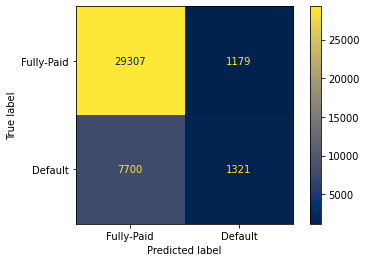

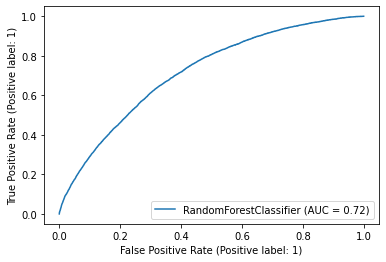

In [50]:
# get predictions and probabilities
y_pred_test, y_prob_test = predict(_X_test, best_clf, thres)

# model evaluation
model_eval, cm, roc = eval_model(_X_test, _y_test, _X_train, _y_train, best_clf, clf_name+'_best_optThres', thres=thres)

### XAI Plots

In [51]:
# LIME charts
run_lime(_X_train, _X_test, best_clf)

In [52]:
# PFI charts
run_pfi(_X_test, _y_test, best_clf)

Weight,Feature
0.0418 ± 0.0027,home_MORTGAGE
0.0326 ± 0.0026,verification_SOURCE_VERIFIED
0.0295 ± 0.0009,verification_NOT_VERIFIED
0.0284 ± 0.0020,home_RENT
0.0187 ± 0.0011,verification_VERIFIED
0.0161 ± 0.0008,home_OWN
0.0154 ± 0.0008,purp_DEBT_CONSOLIDATION
0.0100 ± 0.0021,int_rate
0.0098 ± 0.0007,purp_CREDIT_CARD
0.0078 ± 0.0018,loan_amnt


In [53]:
# pickle model
pickle_model(best_clf, clf_name+'_'+datetime.now(pytz.timezone('US/Pacific')).strftime("%d-%m-%Y_%H-%M"))

'Model saved as: RF_11-01-2023_11-36'

## g) Neural Network

In [49]:
# set hyper-parameters
num_labels = 1
hidden_units = [150, 150, 150]
dropout_rates = [0.1, 0, 0.1, 0]
learn_rate = 1e-3

In [50]:
# fit model
clf_nn = fit_nn(_X_train, _y_train, _X_test, _y_test, _X_train.shape[1], num_labels, hidden_units, dropout_rates,
                learn_rate, epochs=20, batch_size=32)

Epoch 1/20
8890/8890 [==============================] - 68s 7ms/step - loss: 0.4569 - AUC: 0.6976 - val_loss: 280.1070 - val_AUC: 0.5000
Epoch 2/20
8890/8890 [==============================] - 64s 7ms/step - loss: 0.4480 - AUC: 0.7125 - val_loss: 397.4002 - val_AUC: 0.5000
Epoch 3/20
8890/8890 [==============================] - 65s 7ms/step - loss: 0.4466 - AUC: 0.7150 - val_loss: 28.2359 - val_AUC: 0.5074
Epoch 4/20
8890/8890 [==============================] - 63s 7ms/step - loss: 0.4457 - AUC: 0.7170 - val_loss: 113.9129 - val_AUC: 0.5000
Epoch 5/20
8890/8890 [==============================] - 67s 8ms/step - loss: 0.4450 - AUC: 0.7184 - val_loss: 142.5351 - val_AUC: 0.5000
Epoch 6/20
8890/8890 [==============================] - 64s 7ms/step - loss: 0.4444 - AUC: 0.7198 - val_loss: 151.7187 - val_AUC: 0.5085
Epoch 7/20
8890/8890 [==============================] - 67s 8ms/step - loss: 0.4444 - AUC: 0.7197 - val_loss: 68.1857 - val_AUC: 0.5015
Epoch 8/20
8890/8890 [=====================

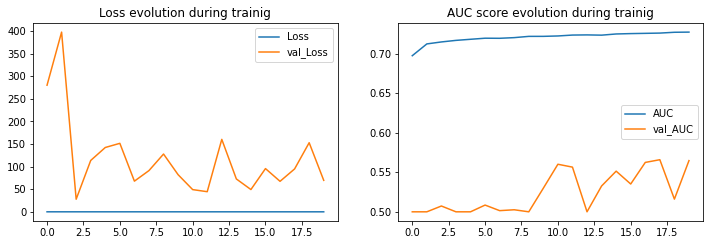

In [51]:
# plot learning evolution
plot_learning_evolution(clf_nn)

In [52]:
# pickle model
pickle_model(clf_nn, 'NN_'+datetime.now(pytz.timezone('US/Pacific')).strftime("%d-%m-%Y_%H-%M"))

INFO:tensorflow:Assets written to: ram://0f805ee4-c71b-4b51-9102-c3f4f9f79dbc/assets


'Model saved as: NN_09-01-2023_13-32'

# ~ CODE GRAVEYARD ~